<a href="https://colab.research.google.com/github/JasonDepblu/potential-spork/blob/main/e8_of_content_based_filtering_explainer2023-11-20.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# pip & load

In [1]:
pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 532.9/532.9 kB 8.2 MB/s eta 0:00:00


In [2]:
# %%
import time
import pandas as pd
import numpy as np
import random
import mpl_toolkits.axisartist as ast
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from tensorflow import keras
import tensorflow as tf
from keras import layers, models, optimizers
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, auc
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.decomposition import PCA
import copy
import shap
import scipy
from tabulate import tabulate
from tensorflow.keras.callbacks import ModelCheckpoint


# 提取特征

In [3]:
# load the data
dsc_up_df = pd.read_csv(r'/content/dsc_up_e8.csv')
car_dict_df = pd.read_csv(r'/content/car_dict_e8.csv')

dsc_up_df = dsc_up_df.replace({np.NaN: 0})
car_dict_df = car_dict_df.replace({np.NaN: 0})


In [4]:
# 将满意度转化为需求
for i in range(len(car_dict_df)):
    for k in ["space","power","maneuverability", "consumption", "comfortableness", "apperance", "internal", "costefficient"]:
        dsc_up_df.loc[dsc_up_df.no_in_car_dict == i, k] = 1/(1+np.exp(dsc_up_df.loc[dsc_up_df.no_in_car_dict == i, k]-dsc_up_df.loc[dsc_up_df.no_in_car_dict == i, k].mean()))



In [5]:
dsc_up_df.head()

,fkoubeiid,space,power,maneuverability,consumption,comfortableness,apperance,internal,costefficient,Pwork,...,fcityid,fbudget,fprovinceid,driving _months,km/d,fseriesname,fseriesid,fspecid,no_in_car_dict,type
0,5172505,0.480779,0.500000,0.316646,0.863675,0.442562,0.480779,0.480779,0.480779,1.0,...,109,29,8,2.0,21.68,传祺M8,4174,58244,37,传祺M8 2024款 双擎系列 2.0TM 基本型
1,5168778,0.500000,0.651355,0.562177,0.468791,0.651355,0.500000,0.437823,0.500000,1.0,...,5,32,10,7.9,27.81,传祺M8,4174,60142,38,传祺M8 2023款 宗师系列 双擎 旗舰
2,5168549,0.500000,0.721280,0.916326,0.694167,0.665639,0.704507,0.669277,0.483612,1.0,...,38,36,7,3.9,29.77,赛那SIENNA,6272,61955,121,赛那SIENNA 2023款 2.5L混动 尊贵版
3,5168444,0.475176,0.432099,0.609974,0.412404,0.387074,0.478275,0.695527,0.507763,0.0,...,48,10,20,0.9,0.00,五菱佳辰,6650,55788,2,五菱佳辰 2022款 1.5T CVT尊享旗舰型
4,5168430,0.288073,0.278406,0.582570,0.452524,0.278406,0.511903,0.464346,0.500000,1.0,...,60,30,2,0.9,91.26,别克GL8,166,58900,101,别克GL8 2023款 ES陆尊 653T 舒适型


In [6]:
dsc_up_df.power.describe()

count    5520.000000
mean        0.496769
std         0.088695
min         0.218694
25%         0.470185
50%         0.487666
75%         0.500000
max         0.953536
Name: power, dtype: float64

In [7]:
dsc_up = dsc_up_df.values
car_dict = car_dict_df.values

print(dsc_up.shape)
print(car_dict.shape)

(5520, 34)
(142, 158)


In [9]:
# load the predict data of year 21-23
dsc_up_pre_df = pd.read_csv(r'/content/dsc_up_e8_pre.csv')
car_dict_pre_df = pd.read_csv(r'/content/car_dict_e8_pre.csv')

dsc_up_pre_df = dsc_up_pre_df.replace({np.NaN: 0})
car_dict_pre_df = car_dict_pre_df.replace({np.NaN: 0})




In [10]:
# 将满意度转化为需求
for i in range(len(car_dict_pre_df)):
    for k in ["space","power","maneuverability", "consumption", "comfortableness", "apperance", "internal", "costefficient"]:
        dsc_up_pre_df.loc[dsc_up_pre_df.no_in_car_dict == i, k] = 1/(1+np.exp(dsc_up_pre_df.loc[dsc_up_pre_df.no_in_car_dict == i, k]-dsc_up_pre_df.loc[dsc_up_pre_df.no_in_car_dict == i, k].mean()))



In [11]:
dsc_up_pre = dsc_up_pre_df.values
car_dict_pre = car_dict_pre_df.values

print(dsc_up_pre.shape)
print(car_dict_pre.shape)

(5520, 34)
(142, 158)


In [12]:
# column of last feature from 0 and +1
col_last_feature_car = 154
# 80
col_last_feature_user = 29

# 提取特征列表
dsc_up_pre_features = dsc_up_pre_df.columns.tolist()
car_dict_pre_features = car_dict_pre_df.columns.tolist()

dsc_up_pre_features = dsc_up_pre_df.columns[1:col_last_feature_user].tolist() # 提取第1至28个特征
car_dict_pre_features = car_dict_pre_df.columns[1:col_last_feature_car].tolist() # 提取第1至155个特征

print(dsc_up_pre_features)
print(car_dict_pre_features)
print(dsc_up_pre_features[-1])
print(car_dict_pre_features[-1])

['space', 'power', 'maneuverability', 'consumption', 'comfortableness', 'apperance', 'internal', 'costefficient', 'Pwork', 'Pshopping', 'Pkids', 'Ptraval', 'Pgoods', 'Pbussiness', 'Pldistance', 'Pdating', 'Pcross', 'Pracing', 'Pnettaxi', 'Prefit', 'Pteam', 'Pgirl', 'fdrivenkiloms', 'fcityid', 'fbudget', 'fprovinceid', 'driving _months', 'km/d']
['price', 'company', 'level', 'type_energy', 'quality_insurance_time', 'quality_insurance_mileage', 'quick_charge_time(80%)', 'slow_charge_time', 'power_car', 'torque_car', 'type_car', 'max_speed', 'time_for_100km_h', 'pure_electric_endurance_mileage', 'endurance_mileage', 'engine_type1', 'gears', 'mission', 'type_motor', 'total_torque_motor', 'maximum_power_of_front_motor', 'Maximum torque of front motor', 'Maximum torque of front motor.1', 'Maximum power of rear motor', 'Maximum torque of rear motor', 'Number of drive motors', 'Motor layout', 'Battery type', 'Battery group warranty1', 'Battery group warranty2', 'driving_pattern', 'Front suspen

In [13]:
num_cars = len(car_dict)
num_cars_pre = len(car_dict_pre)
print(f'The No. of cars in fundamental model dataset : {num_cars}')
print(f'The No. of cars in prediction dataset : {num_cars_pre}')

The No. of cars in fundamental model dataset : 142
The No. of cars in prediction dataset : 142


# 平衡样本

In [14]:
# balance dsc_up samples
dsc_up_bal = np.empty(shape=(1, dsc_up.shape[1]))

for i in range(num_cars):
  if len(dsc_up[dsc_up[:, 32] == i]) > 300:
    ran_row_bal = np.random.choice(np.arange(len(dsc_up[dsc_up[:, 32] == i])), size=300, replace=False)
    dsc_up_bali = dsc_up[dsc_up[:, 32] == i][ran_row_bal]
  else:
    dsc_up_bali = dsc_up[dsc_up[:, 32] == i]
  dsc_up_bal = np.concatenate((dsc_up_bal, dsc_up_bali), axis=0)
dsc_up = dsc_up_bal[1:]
print(dsc_up.shape)

(4945, 34)


In [15]:
# load the label
print(f'The shape of cars dict of the fundamental model dataset : {car_dict.shape}')
print(f'The shape of users list of the fundamental model dataset : {dsc_up.shape}')

print(f'The shape of cars dict of the prediction dataset : {car_dict_pre.shape}')
print(f'The shape of users list of the prediction dataset : {dsc_up_pre.shape}')

ys_up = dsc_up[:, 32]
ys_up_pre = dsc_up_pre[:, 32]
print(f'The label of which user choosed which car in fundamental dataset : {ys_up}')
print(f'The label of which user choosed which car in prediction dataset : {ys_up_pre}')

The shape of cars dict of the fundamental model dataset : (142, 158)
The shape of users list of the fundamental model dataset : (4945, 34)
The shape of cars dict of the prediction dataset : (142, 158)
The shape of users list of the prediction dataset : (5520, 34)
The label of which user choosed which car in fundamental dataset : [0 0 0 ... 141 141 141]
The label of which user choosed which car in prediction dataset : [37 38 121 ... 24 23 23]


In [16]:
# transfer the label of fundamental dataset to onehot_code
ys = copy.copy(ys_up.reshape(len(ys_up), 1))
ys -= 1
onehot_encoder = OneHotEncoder(sparse_output=False)
onehot_encoded = onehot_encoder.fit_transform(ys)
ys = onehot_encoded
print(f'The shape of the label of fundamental dataset to onehot_code : {ys.shape}')

# transfer the label of prediction dataset to onehot_code
ys_pre = copy.copy(ys_up_pre.reshape(len(ys_up_pre), 1))
ys_pre -= 1
onehot_encoder_pre = OneHotEncoder(sparse_output=False)
onehot_encoded_pre = onehot_encoder_pre.fit_transform(ys_pre)
ys_pre = onehot_encoded_pre
print(f'The shape of the label of prediction dataset to onehot_code : {ys_pre.shape}')

The shape of the label of fundamental dataset to onehot_code : (4945, 142)
The shape of the label of prediction dataset to onehot_code : (5520, 142)


In [ ]:
# dsc_up.shape

In [17]:


car_unscaled = car_dict[:, 1:col_last_feature_car]
car_pre_unscaled = car_dict_pre[:, 1:col_last_feature_car]
user_unscaled = dsc_up[:, 1:col_last_feature_user]
user_pre_unscaled = dsc_up_pre[:, 1:col_last_feature_user]


# generate the gaussian random no. to budget feature
mu_budget = 0.5
sigma_budget = 2

for i in range(len(user_unscaled)):
    user_unscaled[i, 24] += random.gauss(mu_budget, sigma_budget)

for i in range(len(user_pre_unscaled)):
    user_pre_unscaled[i, 24] += random.gauss(mu_budget, sigma_budget)

# scaling the data
scalerCar = StandardScaler()
scalerCar.fit(car_dict[:, 1:col_last_feature_car])
car = scalerCar.transform(car_dict[:, 1:col_last_feature_car])
car_pre = scalerCar.transform(car_dict_pre[:, 1:col_last_feature_car])

scalerUser = StandardScaler()
scalerUser.fit(dsc_up[:, 1:col_last_feature_user])
user = scalerUser.transform(dsc_up[:, 1:col_last_feature_user])
user_pre = scalerUser.transform(dsc_up_pre[:, 1:col_last_feature_user])

print(np.allclose(car_unscaled.astype(float), scalerCar.inverse_transform(car)))
print(np.allclose(user_unscaled.astype(float), scalerUser.inverse_transform(user)))
print(np.allclose(car_pre_unscaled.astype(float), scalerCar.inverse_transform(car_pre)))
print(np.allclose(user_pre_unscaled.astype(float), scalerUser.inverse_transform(user_pre)))

True
True
True
True


In [18]:
car_unscaled[1, -1]

69.8

In [19]:
user_unscaled.shape

(4945, 28)

# 特征相关性分析

In [ ]:
import seaborn as sns

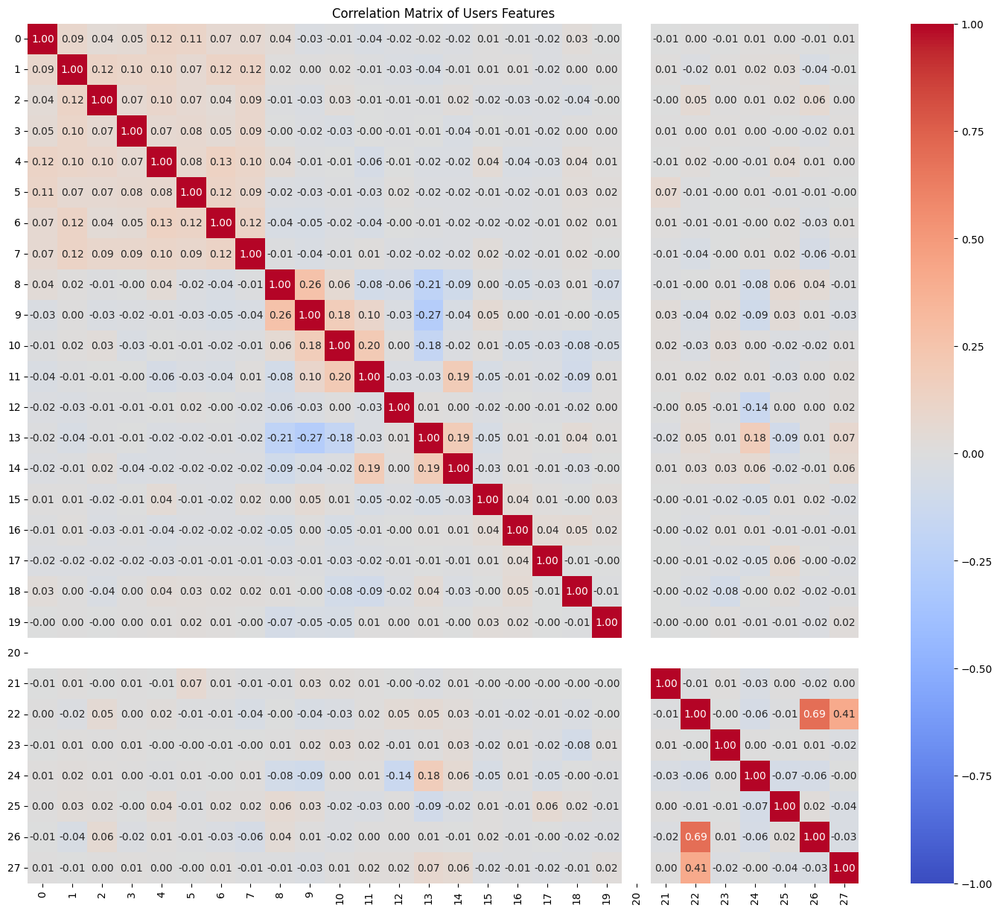

In [ ]:
# Calculate the correlation matrix for the first 28 features
correlation_matrix_user = pd.DataFrame(user).corr()

# Plot the heatmap
plt.figure(figsize=(18, 15))
sns.heatmap(correlation_matrix_user, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
plt.title('Correlation Matrix of Users Features')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [ ]:
# Calculate the correlation matrix for the first 28 features
correlation_matrix_car = pd.DataFrame(car).corr()

# Plot the heatmap
plt.figure(figsize=(108, 105))
sns.heatmap(correlation_matrix_car, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
plt.title('Correlation Matrix of Cars Features')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [ ]:
nofe_cor_check = 81
kcor = 0.6

# Calculate the correlation with 'slow_charge_time' feature
correlation_with_slow_charge_time = pd.DataFrame(car).corr()[nofe_cor_check]

# Filter out features with correlation > kcor
features_high_correlation = correlation_with_slow_charge_time[correlation_with_slow_charge_time.abs() > kcor].index.tolist()
features_high_correlation.remove(nofe_cor_check)  # Remove the 'slow_charge_time' feature itself

feature_names_high_correlation = [car_dict_pre_features[i] for i in features_high_correlation]
high_correlation_with_slow_charge_time = [np.round(correlation_with_slow_charge_time[i], 2) for i in features_high_correlation]

df_high_correlation = pd.DataFrame({
    'Feature': feature_names_high_correlation,
    'Correlation with slow_charge_time': high_correlation_with_slow_charge_time
})

# 显示该DataFrame
print(df_high_correlation)

                                    Feature  Correlation with slow_charge_time
0                                     price                               0.60
1                   Front/rear head airbags                               0.62
2             Lane departure warning system                               0.60
3                Lane keeping assist system                               0.60
4         Active brake/active safety system                               0.60
5                      Driving assist image                               0.74
6                             Cruise system                               0.64
7                            Electric trunk                               0.66
8            Electric trunk position memory                               0.62
9                             Seat material                               0.62
10              Main seat adjustment method                               0.74
11  Main/passenger seat electric adjustment         

In [ ]:
features_high_correlation=[13, 33, 145]

In [ ]:
feature_names_high_correlation = [car_dict_pre_features[i] for i in features_high_correlation]
high_correlation_with_slow_charge_time = [np.round(correlation_with_slow_charge_time[i], 2) for i in features_high_correlation]

df_high_correlation = pd.DataFrame({
    'Feature': feature_names_high_correlation,
    'Correlation with slow_charge_time': high_correlation_with_slow_charge_time
})

# 显示该DataFrame
print(df_high_correlation)

                           Feature  Correlation with slow_charge_time
0  pure_electric_endurance_mileage                               0.33
1               Battery preheating                               0.33
2               Quick charge power                               0.36


# 针对模型进行样本匹配

In [20]:
# func for generating num_items users of different cars
def gen_user_vecs(user_vec, num_items):
    """ given a user vector return:
        user predict matrix to match the size of item_vecs """
    user_vecs = np.tile(user_vec, (1, num_items))
    return user_vecs

def gen_car_vecs(car_vec, num_users):
    car_vecs = np.tile(car_vec, (num_users, 1))
    return car_vecs

PCA(n_components=10)
[0.06804447 0.06491592 0.06153775 0.05164228 0.0421431  0.04083687
 0.03940186 0.03813148 0.03796534 0.03701941]
PCA(n_components=15)
[0.32348931 0.13834855 0.10315716 0.0637119  0.04910285 0.03899742
 0.03321221 0.02677106 0.02284794 0.02058549 0.0171287  0.01593534
 0.01248703 0.0118546  0.01059077]


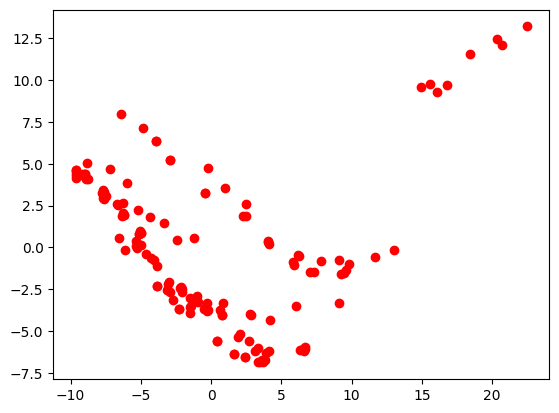

In [21]:
# pca analysis
pca_25 = PCA(n_components=10)
print(pca_25)
pca_25.fit(user)
print(pca_25.explained_variance_ratio_)

# %%
pca_30 = PCA(n_components=15)
print(pca_30)
pca_30.fit(car[:, 1:157])
print(pca_30.explained_variance_ratio_)
c_trans = pca_30.transform(car[:, 1:157])
plt.plot(c_trans[:, 0], c_trans[:, 1], 'ro')


In [22]:
# generate num_items users for different cars
user_vecs = gen_user_vecs(user, len(car_dict))
user_vecs = user_vecs.reshape(-1, user.shape[1])
car_vecs = gen_car_vecs(car, len(dsc_up))
ys = ys.reshape(-1, 1)
print(f'The shape of user matrix in fundamental dataset : {user_vecs.shape}')
print(f'The shape of car matrix in fundamental dataset : {car_vecs.shape}')
print(f'The shape of label matrix in fundamental dataset : {ys.shape}')

user_pre_vecs = gen_user_vecs(user_pre, len(car_dict_pre))
user_pre_vecs = user_pre_vecs.reshape(-1, user_pre.shape[1])
car_pre_vecs = gen_car_vecs(car_pre, len(dsc_up_pre))
ys_pre = ys_pre.reshape(-1, 1)
print(f'The shape of user matrix in prediction dataset : {user_pre_vecs.shape}')
print(f'The shape of car matrix in prediction dataset : {car_pre_vecs.shape}')
print(f'The shape of label matrix in fundamental dataset : {ys_pre.shape}')

The shape of user matrix in fundamental dataset : (702190, 28)
The shape of car matrix in fundamental dataset : (702190, 153)
The shape of label matrix in fundamental dataset : (702190, 1)
The shape of user matrix in prediction dataset : (783840, 28)
The shape of car matrix in prediction dataset : (783840, 153)
The shape of label matrix in fundamental dataset : (783840, 1)


In [23]:
print(ys[ys == 0].shape)
print(ys_pre[ys_pre == 0].shape)

(697245,)
(778320,)


In [24]:
randnum = random.randint(0, 100)
print(randnum)
random.seed(randnum)

79


In [25]:
# case 3
# Random choose the users which label is 0 in fundamental dataset

user_vecs_one = user_vecs[(ys == 1)[:, 0]]
user_vecs_zero = user_vecs[(ys == 0)[:, 0]]
num_users = user_vecs_one.shape[0]
num_zeros = user_vecs_zero.shape[0]
random.seed(randnum)

sample_row = np.random.choice(np.arange(num_zeros), size=np.ceil(num_users * 1.2).astype(int), replace=False)
user_vecs_zero = user_vecs_zero[sample_row]
user_vecs = np.concatenate((user_vecs_zero, user_vecs_one), axis=0)

# random.seed(44)
shuffle_row = np.random.choice(np.arange(0,len(user_vecs)), len(user_vecs), replace=False)
user_vecs = user_vecs[shuffle_row]
print(f'The shape of the users data in fundatmental dataset after balancing : {user_vecs.shape}')

The shape of the users data in fundatmental dataset after balancing : (10879, 28)


In [26]:
# case3
# Random choose the cars which label is 0 in fundamental dataset

car_vecs_one = car_vecs[(ys == 1)[:, 0]]
car_vecs_zero = car_vecs[(ys == 0)[:, 0]][sample_row]
car_vecs = np.concatenate((car_vecs_zero, car_vecs_one), axis=0)

car_vecs = car_vecs[shuffle_row]
print(f'The shape of the cars data in fundatmental dataset after balancing : {car_vecs.shape}')

The shape of the cars data in fundatmental dataset after balancing : (10879, 153)


In [27]:
# case 3
# Random choose the label which is 0 in fundamental dataset
ys_one = ys[(ys == 1)[:, 0]]
ys_zero = ys[(ys == 0)[:, 0]][sample_row]
ys = np.concatenate((ys_zero, ys_one), axis=0)

ys = ys[shuffle_row]
print(f'The shape of label data in fundatmental dataset after balancing : {ys.shape}')

The shape of label data in fundatmental dataset after balancing : (10879, 1)


In [28]:
# Random choose the users which label is 0 in prediction dataset

user_pre_vecs_one = user_pre_vecs[(ys_pre == 1)[:, 0]]
user_pre_vecs_zero = user_pre_vecs[(ys_pre == 0)[:, 0]]
num_users_pre = user_pre_vecs_one.shape[0]
num_zeros_pre = user_pre_vecs_zero.shape[0]
random.seed(randnum)

sample_row_pre = np.random.choice(np.arange(num_zeros_pre), size=np.ceil(num_users_pre * 1.2).astype(int), replace=False)
user_pre_vecs_zero = user_pre_vecs_zero[sample_row_pre]
user_pre_vecs = np.concatenate((user_pre_vecs_zero, user_pre_vecs_one), axis=0)

# random.seed(54)
shuffle_row_pre = np.random.choice(np.arange(0,len(user_pre_vecs)), len(user_pre_vecs), replace=False)
user_pre_vecs = user_pre_vecs[shuffle_row_pre]
# user_pre_vecs = user_vecs[shuffle_row_pre]??
print(f'The shape of the users data in fundatmental dataset after balancing : {user_pre_vecs.shape}')

The shape of the users data in fundatmental dataset after balancing : (12144, 28)


In [29]:
# Random choose the cars which label is 0 in prediction dataset

car_pre_vecs_one = car_pre_vecs[(ys_pre == 1)[:, 0]]
car_pre_vecs_zero = car_pre_vecs[(ys_pre == 0)[:, 0]][sample_row_pre]
car_pre_vecs = np.concatenate((car_pre_vecs_zero, car_pre_vecs_one), axis=0)

car_pre_vecs = car_pre_vecs[shuffle_row_pre]
print(f'The shape of the cars data in prediction dataset after balancing : {car_pre_vecs.shape}')

The shape of the cars data in prediction dataset after balancing : (12144, 153)


In [30]:
# Random choose the label which is 0 in prediction dataset
ys_pre_one = ys_pre[(ys_pre == 1)[:, 0]]
ys_pre_zero = ys_pre[(ys_pre == 0)[:, 0]][sample_row_pre]
ys_pre = np.concatenate((ys_pre_zero, ys_pre_one), axis=0)

ys_pre = ys_pre[shuffle_row_pre]
print(f'The shape of label data in prediction dataset after balancing : {ys_pre.shape}')

The shape of label data in prediction dataset after balancing : (12144, 1)


In [31]:
# case 3
# 对所有数据进行拆分以获取训练集和测试集
(user_train, user_test,
 car_train, car_test,
 ys_train, ys_test) = train_test_split(user_vecs, car_vecs, ys, train_size=0.8, shuffle=True, stratify=ys, random_state=2023)

# 对测试集进行进一步拆分以获得验证集和最终的测试集
(user_val, user_test,
 car_val, car_test,
 ys_val, ys_test) = train_test_split(user_test, car_test, ys_test, train_size=0.5, shuffle=True, stratify=ys_test, random_state=2023)

In [32]:
print(f"cars training data shape:{car_train.shape}")
print(f"cars validating data shape:{car_val.shape}")
print(f"cars testing data shape:{car_test.shape}")

print(f"users training data shape:{user_train.shape}")
print(f"users validating data shape:{user_val.shape}")
print(f"users testing data shape:{user_test.shape}")

print(f"ys training data shape:{ys_train.shape}")
print(f"ys validating data shape:{ys_val.shape}")
print(f"ys testing data shape:{ys_test.shape}")

cars training data shape:(8703, 153)
cars validating data shape:(1088, 153)
cars testing data shape:(1088, 153)
users training data shape:(8703, 28)
users validating data shape:(1088, 28)
users testing data shape:(1088, 28)
ys training data shape:(8703, 1)
ys validating data shape:(1088, 1)
ys testing data shape:(1088, 1)


In [33]:
num_user_features = col_last_feature_user-1
num_car_features = col_last_feature_car-1
num_outputs = 32

Model: "model_17"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_44 (InputLayer)       [(None, 28)]                 0         []                            
                                                                                                  
 input_45 (InputLayer)       [(None, 153)]                0         []                            
                                                                                                  
 sequential_24 (Sequential)  (None, 32)                   729056    ['input_44[0][0]']            
                                                                                                  
 sequential_25 (Sequential)  (None, 32)                   857056    ['input_45[0][0]']            
                                                                                           

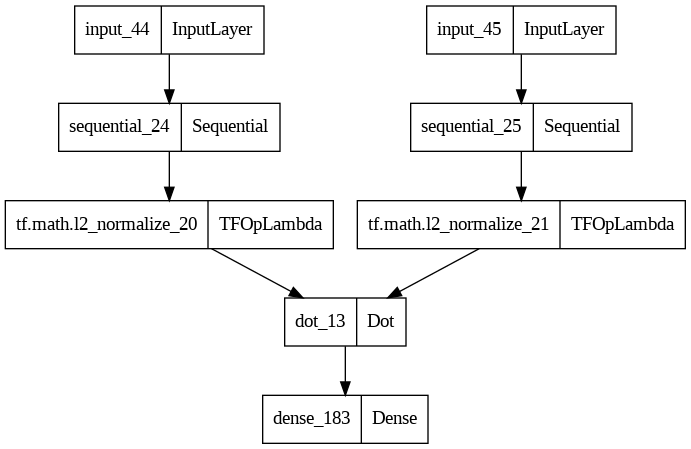

In [ ]:

tf.random.set_seed(1)
user_NN = tf.keras.models.Sequential([
    tf.keras.layers.Dense(1024, activation='swish'),
    tf.keras.layers.Dense(512, activation='swish'),
    tf.keras.layers.Dense(256, activation='swish'),
    tf.keras.layers.Dense(128, activation='swish'),
    tf.keras.layers.Dense(64, activation='swish'),
    tf.keras.layers.Dense(num_outputs, activation='swish'),
])
car_NN = tf.keras.models.Sequential([
    tf.keras.layers.Dense(1024, activation='swish'),
    tf.keras.layers.Dense(512, activation='swish'),
    tf.keras.layers.Dense(256, activation='swish'),
    tf.keras.layers.Dense(128, activation='swish'),
    tf.keras.layers.Dense(64, activation='swish'),
    tf.keras.layers.Dense(num_outputs, activation='swish'),
])

input_user = tf.keras.layers.Input(shape=(num_user_features))
vu = user_NN(input_user)
vu = tf.linalg.l2_normalize(vu, axis=1)

input_car = tf.keras.layers.Input(shape=(num_car_features))
vc = car_NN(input_car)
vc = tf.linalg.l2_normalize(vc, axis=1)

d_out = tf.keras.layers.Dot(axes=1)([vu, vc])
output = tf.keras.layers.Dense(1, activation='sigmoid')(d_out)

model = tf.keras.Model([input_user, input_car], output)
model.summary()
tf.keras.utils.plot_model(model, "/content/my_model.png")

基于NCF模型

In [ ]:
user_NN = tf.keras.models.Sequential([
    # tf.keras.layers.Dense(1024, activation='swish'),
    tf.keras.layers.Dense(512, activation='swish'),
    tf.keras.layers.Dense(256, activation='swish'),
    tf.keras.layers.Dense(128, activation='swish'),
    # tf.keras.layers.Dense(64, activation='swish'),
    tf.keras.layers.Dense(num_outputs, activation='swish'),
])
car_NN = tf.keras.models.Sequential([
    # tf.keras.layers.Dense(1024, activation='swish'),
    tf.keras.layers.Dense(512, activation='swish'),
    tf.keras.layers.Dense(256, activation='swish'),
    tf.keras.layers.Dense(128, activation='swish'),
    # tf.keras.layers.Dense(64, activation='swish'),
    tf.keras.layers.Dense(num_outputs, activation='swish'),
])

In [ ]:
def create_ncf_model(num_user_features, num_car_features, num_outputs):
    # GMF part
    input_user_gmf = tf.keras.layers.Input(shape=(num_user_features,))
    input_car_gmf = tf.keras.layers.Input(shape=(num_car_features,))
    vu_gmf = user_NN(input_user_gmf)
    vc_gmf = car_NN(input_car_gmf)
    gmf_product = tf.keras.layers.Multiply()([vu_gmf, vc_gmf])

    # MLP part
    input_user_mlp = tf.keras.layers.Input(shape=(num_user_features,))
    input_car_mlp = tf.keras.layers.Input(shape=(num_car_features,))
    vu_mlp = user_NN(input_user_mlp)
    vc_mlp = car_NN(input_car_mlp)
    mlp_concat = tf.keras.layers.Concatenate()([vu_mlp, vc_mlp])
    mlp_dropout = tf.keras.layers.Dropout(0.8)(mlp_concat)  # add dropout for regularization
    mlp_layer = tf.keras.layers.Dense(64, activation='relu')(mlp_dropout)
    mlp_layer = tf.keras.layers.Dense(32, activation='relu')(mlp_layer)

    # Combine GMF + MLP
    ncf_concat = tf.keras.layers.Concatenate()([gmf_product, mlp_layer])
    ncf_out = tf.keras.layers.Dense(1, activation='sigmoid')(ncf_concat)

    ncf_model = tf.keras.Model([input_user_gmf, input_car_gmf, input_user_mlp, input_car_mlp], ncf_out)
    return ncf_model


Model: "model_16"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_40 (InputLayer)       [(None, 28)]                 0         []                            
                                                                                                  
 input_41 (InputLayer)       [(None, 153)]                0         []                            
                                                                                                  
 input_42 (InputLayer)       [(None, 28)]                 0         []                            
                                                                                                  
 input_43 (InputLayer)       [(None, 153)]                0         []                            
                                                                                           

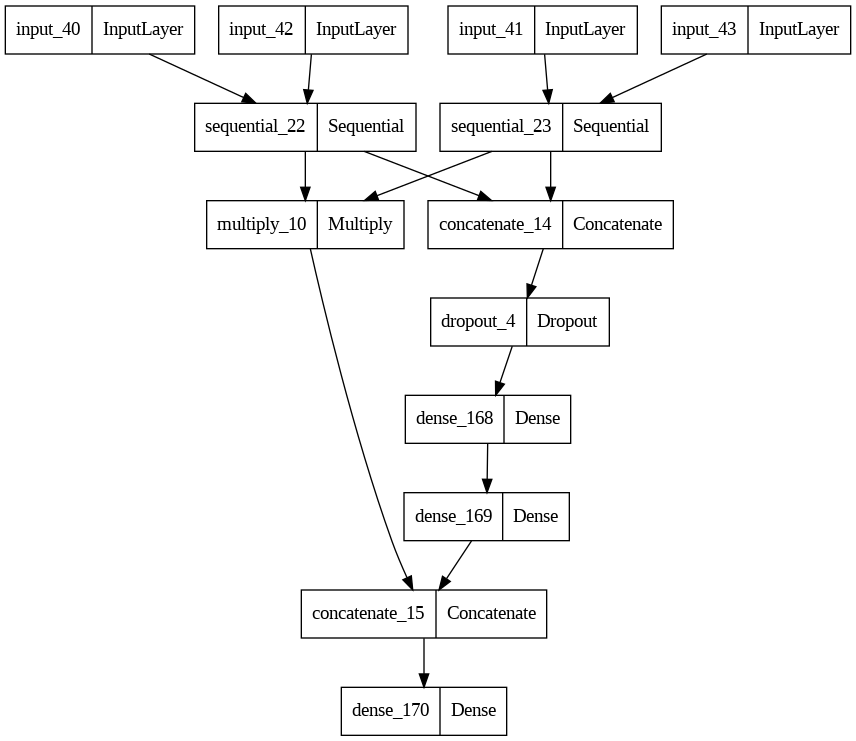

In [ ]:
model = create_ncf_model(num_user_features, num_car_features, num_outputs)
# model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()
tf.keras.utils.plot_model(model, "/content/my_model.png")

attention 机制

In [107]:
tf.random.set_seed(1)
user_NN = tf.keras.models.Sequential([
    # tf.keras.layers.Dense(1024, activation='swish'),
    tf.keras.layers.Dense(512, activation='swish'),
    tf.keras.layers.Dense(256, activation='swish'),
    tf.keras.layers.Dense(128, activation='swish'),
    tf.keras.layers.Dense(64, activation='swish'),
    tf.keras.layers.Dense(num_outputs, activation='swish'),
])
car_NN = tf.keras.models.Sequential([
    # tf.keras.layers.Dense(1024, activation='swish'),
    tf.keras.layers.Dense(512, activation='swish'),
    tf.keras.layers.Dense(256, activation='swish'),
    tf.keras.layers.Dense(128, activation='swish'),
    tf.keras.layers.Dense(64, activation='swish'),
    tf.keras.layers.Dense(num_outputs, activation='swish'),
])

In [108]:
def attention_mechanism(user_tensor, car_tensor):
    """
    Implement a simple dot-product attention between user and car tensors.
    """
    # Compute attention scores
    attention_scores = tf.keras.layers.Dot(axes=1)([user_tensor, car_tensor])

    # Compute attention weights for user tensor
    user_attention_weights = tf.keras.layers.Activation("softmax")(attention_scores)
    user_weighted_tensor = tf.keras.layers.Multiply()([user_tensor, user_attention_weights])

    # Compute attention weights for car tensor
    car_attention_weights = tf.keras.layers.Activation("softmax")(attention_scores)
    car_weighted_tensor = tf.keras.layers.Multiply()([car_tensor, car_attention_weights])

    # Combine the original tensor and the weighted tensor
    user_output = tf.keras.layers.Concatenate()([user_tensor, user_weighted_tensor])
    car_output = tf.keras.layers.Concatenate()([car_tensor, car_weighted_tensor])

    return user_output, car_output

In [109]:
input_user = tf.keras.layers.Input(shape=(num_user_features,))
vu_original = user_NN(input_user)

input_car = tf.keras.layers.Input(shape=(num_car_features,))
vc_original = car_NN(input_car)

vu, vc = attention_mechanism(vu_original, vc_original)

vu = tf.linalg.l2_normalize(vu, axis=1)
vc = tf.linalg.l2_normalize(vc, axis=1)

d_out = tf.keras.layers.Dot(axes=1)([vu, vc])
output = tf.keras.layers.Dense(1, activation='sigmoid')(d_out)

model = tf.keras.Model([input_user, input_car], output)
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 28)]                 0         []                            
                                                                                                  
 input_6 (InputLayer)        [(None, 153)]                0         []                            
                                                                                                  
 sequential_4 (Sequential)   (None, 32)                   189408    ['input_5[0][0]']             
                                                                                                  
 sequential_5 (Sequential)   (None, 32)                   253408    ['input_6[0][0]']             
                                                                                            

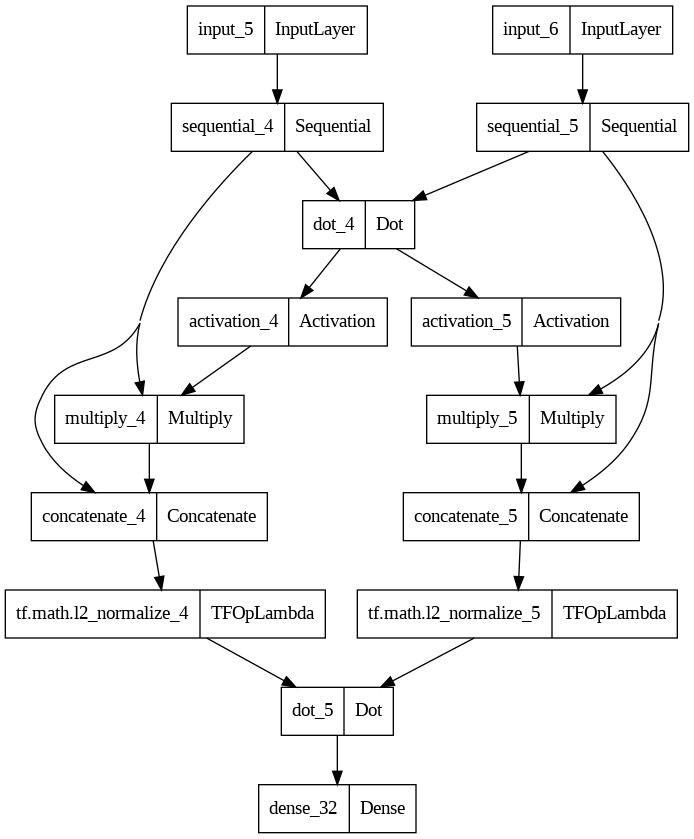

In [110]:
tf.keras.utils.plot_model(model, "/content/my_model.png")

残差连接尝试

In [ ]:
def create_NN_with_residuals(input_dim, num_outputs):
    inputs = tf.keras.layers.Input(shape=(input_dim,))

    x1 = tf.keras.layers.Dense(1024, activation='LeakyReLU')(inputs)

    x2 = tf.keras.layers.Dense(512, activation='LeakyReLU')(x1)
    x3 = tf.keras.layers.Dense(512, activation='LeakyReLU')(x2)
    x3 = tf.keras.layers.add([x2, x3])  # Residual connection between the 2nd and 3rd layers

    x4 = tf.keras.layers.Dense(256, activation='LeakyReLU')(x3)

    x5 = tf.keras.layers.Dense(128, activation='LeakyReLU')(x4)
    x6 = tf.keras.layers.Dense(128, activation='LeakyReLU')(x5)
    x6 = tf.keras.layers.add([x5, x6])  # Residual connection between the 4th and 5th layers

    x7 = tf.keras.layers.Dense(64, activation='LeakyReLU')(x6)

    outputs = tf.keras.layers.Dense(num_outputs, activation='LeakyReLU')(x7)
    outputs = tf.linalg.l2_normalize(outputs, axis=1)

    model = tf.keras.models.Model(inputs=inputs, outputs=outputs)
    return model

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_13 (InputLayer)       [(None, 28)]                 0         []                            
                                                                                                  
 input_14 (InputLayer)       [(None, 153)]                0         []                            
                                                                                                  
 model_5 (Functional)        (None, 32)                   1008224   ['input_13[0][0]']            
                                                                                                  
 model_6 (Functional)        (None, 32)                   1136224   ['input_14[0][0]']            
                                                                                            

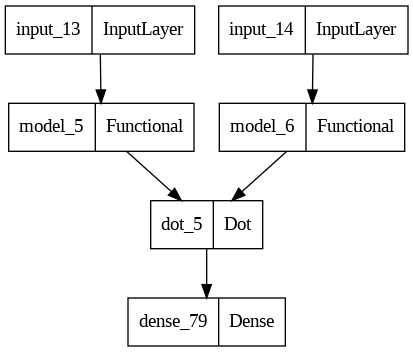

In [ ]:
# Create the user and car neural networks with residual connections
user_NN_with_residuals = create_NN_with_residuals(num_user_features, num_outputs)
car_NN_with_residuals = create_NN_with_residuals(num_car_features, num_outputs)

# Combined model
input_user = tf.keras.layers.Input(shape=(num_user_features,))
vu = user_NN_with_residuals(input_user)

input_car = tf.keras.layers.Input(shape=(num_car_features,))
vc = car_NN_with_residuals(input_car)

d_out = tf.keras.layers.Dot(axes=1)([vu, vc])
output = tf.keras.layers.Dense(1, activation='sigmoid')(d_out)

model_with_residuals = tf.keras.Model([input_user, input_car], output)
model_with_residuals.summary()
tf.keras.utils.plot_model(model_with_residuals, "/content/my_model.png")

In [111]:
def contrastive_loss(y_true, y_pred, margin=0.8):
    """
    Contrastive loss function.
    - y_true: True labels, 1 for positive pairs, 0 for negative pairs.
    - y_pred: Predicted labels.
    - margin: Contrastive margin.
    """
    # 计算正样本的损失（用户购买车型）
    positive_loss = y_true * tf.square(tf.maximum(margin - y_pred, 0))

    # 计算负样本的损失（用户未购买车型）
    negative_loss = (1 - y_true) * tf.square(y_pred)

    # 计算总损失
    loss = tf.reduce_mean(positive_loss + negative_loss)
    return loss

In [112]:
# tf.random.set_seed(1)
cost_fn = tf.keras.losses.MeanSquaredError()
opt = keras.optimizers.Adam(learning_rate=0.0025)
model.compile(optimizer=opt, loss=contrastive_loss)

In [113]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                  patience=10, # number of epochs to wait
                                                  restore_best_weights=True)


In [114]:
reduce_lr_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', # monitor the validation loss
    factor=0.1,         # reduce the learning rate to 10% of its current value
    patience=5,         # reduce the learning rate if the metric does not improve for 5 consecutive epochs
    min_lr=1e-6,        # set the minimum learning rate
    verbose=1           # print messages about learning rate reduction
)

In [115]:
# 创建ModelCheckpoint回调
checkpoint_filepath = '/content/best_model2.h5'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_best_only=True,
    monitor='val_loss',
    mode='min',
    verbose=1,
    save_weights_only=False # 保存整个模型。如果只想保存权重，设置为True。
)


In [116]:
# tf.random.set_seed(1)
# model.fit([user_train, car_train], ys_train, epochs=12)
history = model.fit([user_train, car_train], ys_train,
                    validation_data=([user_val, car_val], ys_val),
                    epochs=100,
                    callbacks = [model_checkpoint_callback, early_stopping, reduce_lr_callback])


Epoch 1/100
265/272 [============================>.] - ETA: 0s - loss: 0.1184
Epoch 1: val_loss improved from inf to 0.10891, saving model to /content/best_model2.h5
272/272 [==============================] - 5s 7ms/step - loss: 0.1181 - val_loss: 0.1089 - lr: 0.0025
Epoch 2/100
 19/272 [=>............................] - ETA: 1s - loss: 0.1044

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.


265/272 [============================>.] - ETA: 0s - loss: 0.0967
Epoch 2: val_loss improved from 0.10891 to 0.09779, saving model to /content/best_model2.h5
272/272 [==============================] - 2s 6ms/step - loss: 0.0966 - val_loss: 0.0978 - lr: 0.0025
Epoch 3/100
270/272 [============================>.] - ETA: 0s - loss: 0.0851
Epoch 3: val_loss improved from 0.09779 to 0.09203, saving model to /content/best_model2.h5
272/272 [==============================] - 2s 6ms/step - loss: 0.0851 - val_loss: 0.0920 - lr: 0.0025
Epoch 4/100
271/272 [============================>.] - ETA: 0s - loss: 0.0793
Epoch 4: val_loss improved from 0.09203 to 0.08537, saving model to /content/best_model2.h5
272/272 [==============================] - 2s 6ms/step - loss: 0.0792 - val_loss: 0.0854 - lr: 0.0025
Epoch 5/100
264/272 [============================>.] - ETA: 0s - loss: 0.0731
Epoch 5: val_loss improved from 0.08537 to 0.07851, saving model to /content/best_model2.h5
272/272 [=================

In [41]:
# Using the same user and car data for both GMF and MLP parts
history = ncf_model.fit([user_train, car_train, user_train, car_train], ys_train,
                        validation_data=([user_val, car_val, user_val, car_val], ys_val),
                        epochs=100,
                        callbacks=[model_checkpoint_callback, early_stopping])


Epoch 1/100


ValueError: ignored

In [42]:
# 加载 model
from tensorflow.keras.models import load_model
best_model = load_model(checkpoint_filepath)

In [117]:
model.evaluate([user_val, car_val], ys_val)

34/34 [==============================] - 0s 2ms/step - loss: 0.0656


0.06564784795045853

In [118]:
model.evaluate([user_val[(ys_val == 0)[:, 0]], car_val[(ys_val == 0)[:, 0]]], ys_val[(ys_val == 0)[:, 0]])
model.evaluate([user_val[(ys_val == 1)[:, 0]], car_val[(ys_val == 1)[:, 0]]], ys_val[(ys_val == 1)[:, 0]])

16/16 [==============================] - 0s 2ms/step - loss: 0.0565


0.056488607078790665

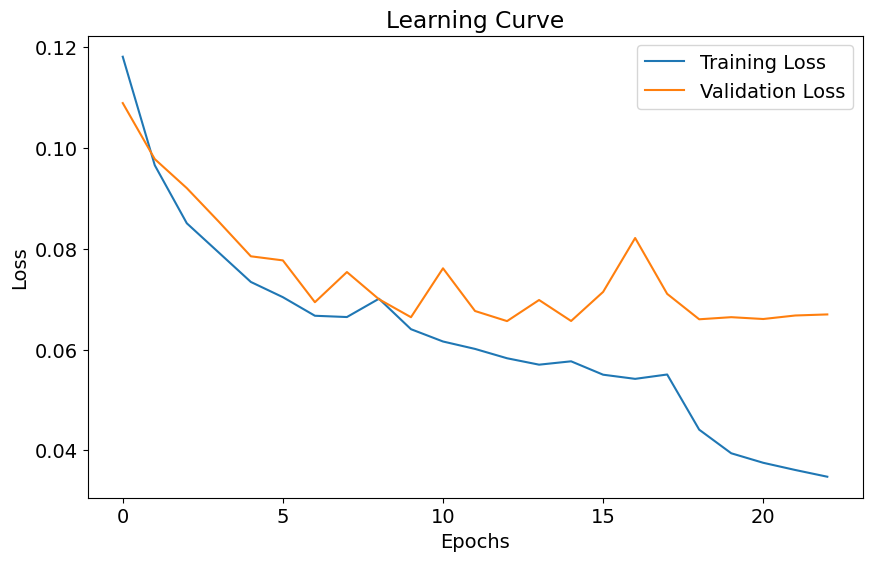

In [119]:
# import matplotlib.pyplot as plt

# Plotting the training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Learning Curve')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


用validation set调参

In [47]:
ys_p_val = model.predict([[user_val, car_val]])

34/34 [==============================] - 0s 2ms/step


In [121]:
# 分类阈值
th_v = 0.6

In [122]:
# print the confusion matrix & report of validation set
ys_p_val_binary = np.where(ys_p_val > th_v, 1, 0)
confusion_val = confusion_matrix(ys_val, ys_p_val_binary)
print(confusion_val)
print(classification_report(ys_val, ys_p_val_binary))

[[504  90]
 [ 80 414]]
              precision    recall  f1-score   support

         0.0       0.86      0.85      0.86       594
         1.0       0.82      0.84      0.83       494

    accuracy                           0.84      1088
   macro avg       0.84      0.84      0.84      1088
weighted avg       0.84      0.84      0.84      1088



In [52]:
ys_test.shape

(1088, 1)

In [123]:
model.evaluate([user_test[(ys_test == 0)[:, 0]], car_test[(ys_test == 0)[:, 0]]], ys_test[(ys_test == 0)[:, 0]])
model.evaluate([user_test[(ys_test == 1)[:, 0]], car_test[(ys_test == 1)[:, 0]]], ys_test[(ys_test == 1)[:, 0]])

16/16 [==============================] - 0s 2ms/step - loss: 0.0516


0.05160117149353027

In [124]:
ys_p_test = model.predict([[user_test, car_test]])
ys_p_test_vs = np.concatenate((ys_p_test, ys_test), axis=1)
ys_test_df = pd.DataFrame(ys_p_test_vs)
ys_test_df.to_csv(r'/content/ys_p_test_6epoch.csv', encoding='UTF-8')

34/34 [==============================] - 0s 2ms/step


In [125]:
# print the confusion matrix & report of test set
print(confusion_matrix(ys_test, np.round(ys_p_test)))
print(classification_report(ys_test, np.round(ys_p_test)))

[[531  62]
 [ 91 404]]
              precision    recall  f1-score   support

         0.0       0.85      0.90      0.87       593
         1.0       0.87      0.82      0.84       495

    accuracy                           0.86      1088
   macro avg       0.86      0.86      0.86      1088
weighted avg       0.86      0.86      0.86      1088



In [126]:
ys_p_test_binary = np.where(ys_p_test > th_v, 1, 0)
confusion_test = confusion_matrix(ys_test, ys_p_test_binary)
print(confusion_test)
print(classification_report(ys_test, ys_p_test_binary))

[[545  48]
 [145 350]]
              precision    recall  f1-score   support

         0.0       0.79      0.92      0.85       593
         1.0       0.88      0.71      0.78       495

    accuracy                           0.82      1088
   macro avg       0.83      0.81      0.82      1088
weighted avg       0.83      0.82      0.82      1088



AUC: 0.9403648627931933


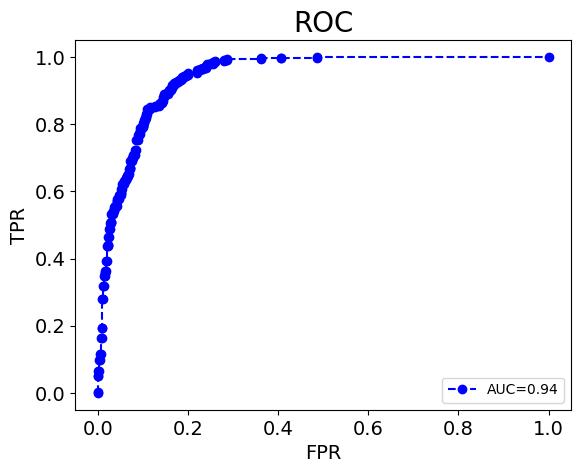

In [127]:
# calculate the auc & roc
FPR, TPR, thresholds = metrics.roc_curve(ys_test, ys_p_test)
AUC = auc(FPR, TPR)
print('AUC:',AUC)
plt.rc('font', family='', size=14)
plt.plot(FPR,TPR,label="AUC={:.2f}" .format(AUC),marker = 'o',color='b',linestyle='--')
plt.legend(loc=4, fontsize=10)
plt.title('ROC',fontsize=20)
plt.xlabel('FPR',fontsize=14)
plt.ylabel('TPR',fontsize=14)
plt.show()

# 可视化模型的权重

In [ ]:
import matplotlib.pyplot as plt


In [ ]:
# 提取权重
user_weights = user_NN.get_weights()
car_weights = car_NN.get_weights()



In [ ]:
# 可视化函数
def visualize_weights(weights, network_name):
    for i, weight_matrix in enumerate(weights):
        # 权重的shape，如果是偏置项，则是一维数组
        if len(weight_matrix.shape) == 2:
            plt.figure(figsize=(12, 6))
            plt.imshow(weight_matrix, cmap='viridis')
            plt.colorbar()
            plt.title(f"{network_name} - Layer {i + 1} Weights")
            plt.show()
        else:
            plt.figure(figsize=(12, 2))
            plt.imshow(weight_matrix.reshape(1, -1), cmap='viridis', aspect='auto')
            plt.colorbar()
            plt.title(f"{network_name} - Layer {i + 1} Biases")
            plt.show()



In [ ]:
# 为用户神经网络和汽车神经网络的权重进行可视化
visualize_weights(user_weights, "User Neural Network")
visualize_weights(car_weights, "Car Neural Network")

#场景1～4 ##########

In [ ]:
ys_p_train = model.predict([[user_train, car_train]])

272/272 [==============================] - 1s 1ms/step


In [ ]:
# print the confusion matrix & report
print(confusion_matrix(ys_train, np.round(ys_p_train)))
print(classification_report(ys_train, np.round(ys_p_train)))

[[3542 1217]
 [ 322 3622]]
              precision    recall  f1-score   support

         0.0       0.92      0.74      0.82      4759
         1.0       0.75      0.92      0.82      3944

    accuracy                           0.82      8703
   macro avg       0.83      0.83      0.82      8703
weighted avg       0.84      0.82      0.82      8703



In [ ]:
# predict the users of year 21-23 whether buy the cars in scope
ys_p_pre = model.predict([user_pre_vecs, car_pre_vecs])

380/380 [==============================] - 1s 1ms/step


In [ ]:
# print the confusion matrix & report
print(confusion_matrix(ys_pre, np.round(ys_p_pre)))
print(classification_report(ys_pre, np.round(ys_p_pre)))

[[4929 1695]
 [ 453 5067]]
              precision    recall  f1-score   support

         0.0       0.92      0.74      0.82      6624
         1.0       0.75      0.92      0.83      5520

    accuracy                           0.82     12144
   macro avg       0.83      0.83      0.82     12144
weighted avg       0.84      0.82      0.82     12144



AUC: 0.9086418978199607


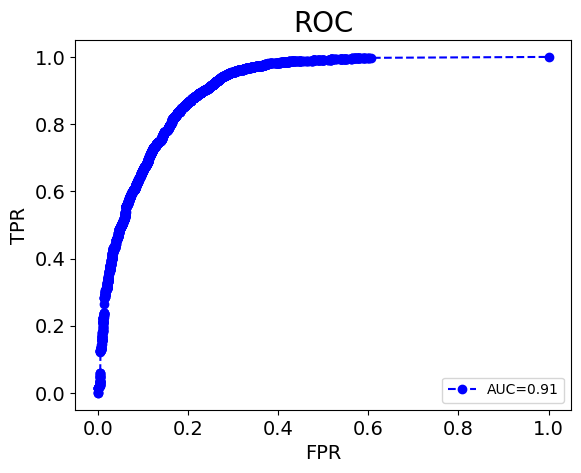

In [ ]:
# calculate the auc & roc
FPR, TPR, thresholds = metrics.roc_curve(ys_pre, ys_p_pre)
AUC = auc(FPR, TPR)
print('AUC:',AUC)
plt.rc('font', family='', size=14)
plt.plot(FPR,TPR,label="AUC={:.2f}" .format(AUC),marker = 'o',color='b',linestyle='--')
plt.legend(loc=4, fontsize=10)
plt.title('ROC',fontsize=20)
plt.xlabel('FPR',fontsize=14)
plt.ylabel('TPR',fontsize=14)
plt.show()

基于某个用户，预测不同的车的购买倾向

In [ ]:
list = []
for i in range(len(dsc_up)):
  if dsc_up[i, 32] == 7:
    list.append(i)
print(list)

[2035, 2036, 2037, 2038, 2039, 2040, 2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056, 2057, 2058, 2059, 2060, 2061, 2062, 2063, 2064, 2065, 2066, 2067, 2068, 2069, 2070, 2071, 2072, 2073, 2074, 2075, 2076, 2077, 2078, 2079, 2080, 2081, 2082, 2083, 2084, 2085, 2086, 2087, 2088, 2089, 2090, 2091, 2092, 2093, 2094, 2095, 2096, 2097, 2098, 2099, 2100, 2101, 2102, 2103, 2104, 2105, 2106, 2107, 2108, 2109, 2110, 2111, 2112, 2113, 2114, 2115, 2116, 2117, 2118, 2119, 2120, 2121, 2122, 2123, 2124, 2125, 2126, 2127, 2128, 2129, 2130, 2131, 2132, 2133, 2134, 2135, 2136, 2137, 2138, 2139, 2140, 2141, 2142, 2143, 2144, 2145, 2146, 2147, 2148, 2149, 2150, 2151, 2152, 2153, 2154, 2155, 2156, 2157, 2158, 2159, 2160, 2161, 2162, 2163, 2164, 2165, 2166, 2167, 2168, 2169, 2170, 2171, 2172, 2173, 2174, 2175, 2176, 2177, 2178, 2179, 2180, 2181, 2182, 2183, 2184, 2185, 2186, 2187, 2188, 2189, 2190, 2191, 2192, 2193, 2194, 2195, 2196, 2197, 2198, 2199, 2200, 220

In [ ]:
dsc_up[2047, :]

array([3358153, 3, 3, 3, 2, 3, 3, 4, 3, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,
       0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2300, 3, 7.911861159554745, 5,
       3, 24, '宋Pro', 5178, 40569, 7, '2019款 1.5T 自动豪华型', 40569],
      dtype=object)

In [ ]:
# predict the new car of new performance for specific user
# define the cars and the user
row_car_dict = np.arange(0, num_cars)
row_user_dst = [2047]
new_car = car_unscaled[row_car_dict]
new_user = gen_car_vecs(user_unscaled[row_user_dst], len(row_car_dict))

# predict the new car of new performance
new_user_scal = scalerUser.transform(new_user)
new_car_scal = scalerCar.transform(new_car)
new_car_predict = model.predict([[new_user_scal, new_car_scal]])
print(f'target car is {dsc_up[row_user_dst, 33]}, car No. is {dsc_up[row_user_dst, 32]}')
for i in range(len(row_car_dict)):
    print(
        f'{i} :'
        f'{car_dict[row_car_dict, 91].reshape(-1, 1)[i]} : {np.round(new_car_predict[i],3)} : {np.round(new_car_predict[i], 0)}')

In [ ]:
new_y_predict = np.zeros((new_car_predict.shape))
new_y_predict [new_car_predict > 0.8] = 1
new_y_true = np.zeros((new_y_predict.shape))
new_y_true[row_car_dict == dsc_up[row_user_dst, 32]] = 1

print(confusion_matrix(new_y_true, new_y_predict))
print(classification_report(new_y_true, new_y_predict))


[[186   4]
 [  0   1]]
              precision    recall  f1-score   support

         0.0       1.00      0.98      0.99       190
         1.0       0.20      1.00      0.33         1

    accuracy                           0.98       191
   macro avg       0.60      0.99      0.66       191
weighted avg       1.00      0.98      0.99       191



In [ ]:
dsc_up[row_user_dst, 32]

array([7], dtype=object)

In [ ]:
new_y_predict_vs = np.concatenate((new_y_predict, new_y_true), axis=1)
new_y_predict_vs = np.concatenate((new_car_predict, new_y_predict_vs), axis=1)
new_y_predict_df = pd.DataFrame(new_y_predict_vs)
new_y_predict_df.to_csv(r'/content/new_car_predict_vs.csv', encoding='UTF-8')

基于某款车预测不同用户的购买倾向

In [ ]:
row_car_dict = [7]
row_user_dst = np.arange(0, num_users)
new_car = gen_car_vecs(car_unscaled[row_car_dict], len(row_user_dst))
new_user = user_unscaled[row_user_dst]

new_user_scal = scalerUser.transform(new_user)
new_car_scal = scalerCar.transform(new_car)
new_car_predict = model.predict([[new_user_scal, new_car_scal]])

print(f'target car is {car_dict[row_car_dict, 91]}, car No. is {car_dict[row_car_dict, 92]}')
for i in range(min(len(row_user_dst), 200)):
    print(
        f'User{i} who has bought car:'
        f'{dsc_up[row_user_dst, 29].reshape(-1, 1)[i]} : {np.round(new_car_predict[i],3)} : {np.round(new_car_predict[i], 0)}')

In [ ]:
new_y_predict = np.zeros((new_car_predict.shape))
new_y_predict [new_car_predict > 0.86] = 1
new_y_true = np.zeros((new_y_predict.shape))
new_y_true[dsc_up[row_user_dst, 32] == row_car_dict] = 1

print(confusion_matrix(new_y_true, new_y_predict))
print(classification_report(new_y_true, new_y_predict))

[[29750 13445]
 [  212   788]]
              precision    recall  f1-score   support

         0.0       0.99      0.69      0.81     43195
         1.0       0.06      0.79      0.10      1000

    accuracy                           0.69     44195
   macro avg       0.52      0.74      0.46     44195
weighted avg       0.97      0.69      0.80     44195



In [ ]:
new_y_predict_vs = np.concatenate((new_y_predict, new_y_true), axis=1)
new_y_predict_vs = np.concatenate((new_car_predict, new_y_predict_vs), axis=1)
new_y_predict_vs = np.concatenate((dsc_up[row_user_dst, 32].reshape(-1, 1), new_y_predict_vs), axis=1)
new_y_predict_df = pd.DataFrame(new_y_predict_vs)
new_y_predict_df.to_csv(r'/content/new_user_predict_vs3.csv', encoding='UTF-8')

In [ ]:
new_y_predict [new_car_predict > 0.86].shape

(14233,)

修改某款车性能参数，预测不同用户的购买倾向

In [ ]:
# 32 宋DMIDMI110km
# 56 低配影酷
car_unscaled[56, 0]

11.98

In [ ]:
# base car parameters
row_car_dict = [56]
row_user_dst = np.arange(0, num_users)
new_car_one = car_unscaled[row_car_dict]
print(new_car_one)

[[11.98 7 1 2 1 0.0 0.0 130 270 1 190 8.35 0 735 3.0 350.0 165.0 350.0
  0.0 0.0 1.0 0 0 0 1 1 0 0 4680 1901 1670 2750 1617 1610 1915 1500 5 1 2
  2 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 4 1 1 3 1 4 1 1 1 1 0.0 1 3 1 1 1 1 1
  7.0 0 39.1 58.1 59.5 66.7]]


In [ ]:
# modify the paramters of some car
new_car_one[:, 0:14] = car_unscaled[32, 0:14]
print(new_car_one)

[[17.58 4 1 3 3 0.7 5.5 81 135 1 170 7.9 110 1443 3.0 350.0 165.0 350.0
  0.0 0.0 1.0 0 0 0 1 1 0 0 4680 1901 1670 2750 1617 1610 1915 1500 5 1 2
  2 1 1 1 1 1 1 1 1 1 0 0 0 1 1 1 4 1 1 3 1 4 1 1 1 1 0.0 1 3 1 1 1 1 1
  7.0 0 39.1 58.1 59.5 66.7]]


In [ ]:
new_car = gen_car_vecs(new_car_one, len(row_user_dst))
new_user = user_unscaled[row_user_dst]

new_user_scal = scalerUser.transform(new_user)
new_car_scal = scalerCar.transform(new_car)
new_car_predict = model.predict([[new_user_scal, new_car_scal]])

print(f'target car is {car_dict[row_car_dict, 81]}, car No. is {car_dict[row_car_dict, 82]}')
for i in range(min(len(row_user_dst), 100)):
    print(
        f'User{i} who has bought car:'
        f'{dsc_up[row_user_dst, 32].reshape(-1, 1)[i]} : {np.round(new_car_predict[i],3)} : {np.round(new_car_predict[i], 0)}')

In [ ]:
new_y_predict_modify = np.concatenate((dsc_up[row_user_dst, 32].reshape(-1, 1), new_car_predict), axis=1)
new_y_predict = np.zeros((new_car_predict.shape))
new_y_predict [new_car_predict > 0.8] = 1
new_y_predict_modify = np.concatenate((new_y_predict_modify, new_y_predict), axis=1)
new_y_predict_modify_df = pd.DataFrame(new_y_predict_modify)
new_y_predict_modify_df.to_csv(r'/content/new_user_predict_modify.csv', encoding='UTF-8')

In [ ]:
new_y_predict [new_car_predict > 0.8].shape

(3196,)

In [ ]:
dsc_up.shape

(9492, 33)

**修改某款车参数为未来热销车型参数，预测原有用户是否购买**

---



---



In [ ]:
dsc_up

In [ ]:
new_car = gen_car_vecs(new_car_one, len(row_user_dst))
new_user = user_unscaled[row_user_dst]

new_user_scal = scalerUser.transform(new_user)
new_car_scal = scalerCar.transform(new_car)
new_car_predict = model.predict([[new_user_scal, new_car_scal]])

print(f'target car is {car_dict_pre[row_car_dict, 91]}, car No. is {car_dict_pre[row_car_dict, 91]}')
for i in range(min(len(row_user_dst), 10000)):
    print(
        f'User{i} who has bought car:'
        f'{dsc_up[row_user_dst, 29].reshape(-1, 1)[i]} : {np.round(new_car_predict[i],3)} : {np.round(new_car_predict[i], 0)}')

155/155 [==============================] - 0s 1ms/step


NameError: ignored

In [ ]:
new_car_predict[new_car_predict > 0.8] = 1
new_y_predict_df = pd.DataFrame(new_car_predict)
new_y_predict_df.to_csv(r'/content/new_user_predict.csv', encoding='UTF-8')

In [ ]:
new_y_predict_modify = np.concatenate((dsc_up[row_user_dst, 29].reshape(-1, 1), new_car_predict), axis=1)
new_y_predict = np.zeros((new_car_predict.shape))
new_y_predict [new_car_predict > 0.8] = 1
new_y_predict_modify = np.concatenate((new_y_predict_modify, new_y_predict), axis=1)
new_y_predict_modify_df = pd.DataFrame(new_y_predict_modify)
new_y_predict_modify_df.to_csv(r'/content/new_user_predict_modify_RAV4.csv', encoding='UTF-8')

In [ ]:
new_y_predict [new_car_predict > 0.8].shape

(6663,)

In [ ]:
dsc_up.shape

(44195, 35)

修改用户地点，预测用户购买某款车的倾向变化

In [ ]:
row_car_dict = [11]
row_user_dst = np.arange(0, num_users)
new_car_one = car_unscaled[row_car_dict]
new_car = gen_car_vecs(new_car_one, len(row_user_dst))
new_user = user_unscaled[row_user_dst]

In [ ]:
# modify the place of users
# 吉林：26 长春：295
# 广东：1 广州：115
# 广东：1 深圳：195
new_user[:, (22,24)] = [(115, 1)]
print(new_user[0:10,(22,24)])

[[115 1]
 [115 1]
 [115 1]
 [115 1]
 [115 1]
 [115 1]
 [115 1]
 [115 1]
 [115 1]
 [115 1]]


In [ ]:
new_user[0]

array([3, 3, 2, 3, 2, 3, 3, 3, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,
       0.0, 0.0, 0.0, 0.0, 0.0, 100, 115, 12.383482437349597, 1, 0, 7],
      dtype=object)

In [ ]:
new_user_scal = scalerUser.transform(new_user)
new_car_scal = scalerCar.transform(new_car)
new_car_predict = model.predict([[new_user_scal, new_car_scal]])

print(f'target car is {car_dict[row_car_dict, 81]}, car No. is {car_dict[row_car_dict, 82]}')
for i in range(min(len(row_user_dst), 100)):
    print(
        f'User{i} who has bought car:'
        f'{dsc_up[row_user_dst, 32].reshape(-1, 1)[i]} : {np.round(new_car_predict[i],3)} : {np.round(new_car_predict[i], 0)}')

In [ ]:
threshold_p = 0.23
new_y_predict [new_car_predict > threshold_p].shape

(460,)

In [ ]:
num_users

9492

In [ ]:
new_y_predict_modify = np.concatenate((dsc_up[row_user_dst, 32].reshape(-1, 1), new_car_predict), axis=1)
new_y_predict = np.zeros((new_car_predict.shape))
new_y_predict [new_car_predict > threshold_p] = 1
new_y_predict_modify = np.concatenate((new_y_predict_modify, new_y_predict), axis=1)
new_y_predict_modify_df = pd.DataFrame(new_y_predict_modify)
new_y_predict_modify_df.to_csv(r'/content/new_user_predict_modify_place.csv', encoding='UTF-8')

**others：**

In [ ]:
new_car_predict = np.concatenate((new_car_predict, dsc_up[0:, 30].reshape(-1, 1)), axis=1)
new_car_predict_df = pd.DataFrame(new_car_predict)
new_car_predict_df.to_csv(r'/content/new_car_predict3.csv', encoding='UTF-8')

In [ ]:
a = np.array([0,1,2])
b = np.array([1,2,3])
print(np.dot(a,b))

8


# **E8场景预测：针对爬取的已买MPV相关车型的用户，预测他们是否会购买E8**

In [128]:
# load data
dsc_up_new_df = pd.read_csv(r'/content/dsc_up_e8_pre.csv')
dsc_up_new_df = dsc_up_new_df.replace({np.NaN: 0})

In [129]:
# 将满意度转化为需求
for k in ["space","power","maneuverability", "consumption", "comfortableness", "apperance", "internal", "costefficient"]:
  dsc_up_new_df[k] = 1/(1+np.exp(dsc_up_new_df[k]-dsc_up_new_df[k].mean()))


In [130]:
dsc_up_new = dsc_up_new_df.values
no_user_new = len(dsc_up_new)
print(dsc_up_new.shape, no_user_new)

(5520, 34) 5520


In [131]:
e8_pre_df = pd.read_csv(r'/content/dream2_para.csv')
e8_pre_df = e8_pre_df.replace({np.NaN: 0})
e8_pre = e8_pre_df.values
e8_pre.shape
# print(car_unscaled[0].shape)
# print(col_last_feature_car)

(1, 156)

In [132]:
e8_pre = e8_pre[:, 1:col_last_feature_car]
print(e8_pre.shape)
row_user_dst = np.arange(0, no_user_new)

(1, 153)


In [133]:
new_car_one = e8_pre

In [134]:
no_user_new

5520

In [135]:
new_user_scal.shape

(5520, 28)

In [136]:
new_car_scal.shape

(5520, 153)

In [137]:
new_car = gen_car_vecs(new_car_one, no_user_new)
new_user = dsc_up_new[row_user_dst, 1:col_last_feature_user]

new_user_scal = scalerUser.transform(new_user)
new_car_scal = scalerCar.transform(new_car)
new_car_predict = model.predict([[new_user_scal, new_car_scal]])

173/173 [==============================] - 1s 2ms/step


In [138]:
# all the predictions
new_car_predict_con = np.concatenate((new_car_predict, dsc_up_new[0:, 29].reshape(-1, 1)), axis=1)
new_car_predict_con_df = pd.DataFrame(new_car_predict_con)
new_car_predict_con_df.to_csv(r'/content/new_car_predict_dream22.csv', encoding='UTF-8')

In [63]:
(new_car_predict > th_v).flatten().shape

(5520,)

In [64]:
# 选择该车型的用户数据
chosen_predict = dsc_up_new[(new_car_predict >= th_v).flatten(), 1:]
print(chosen_predict.shape)
# 首先，将这些新名称添加到 dsc_up_pre_features 列表中
additional_features = ["fseriesname", "fseriesid", "fspecid", "no_in_car_dict", "fullname"]
dsc_up_pre_features_extended = dsc_up_pre_features + additional_features
chosen_predict_df = pd.DataFrame(chosen_predict, columns=dsc_up_pre_features_extended)
chosen_predict_df.to_csv(r'/content/chosen_predict.csv', encoding='UTF-8')

(1802, 33)


In [65]:
nochosen_predict = dsc_up_new[(new_car_predict < th_v).flatten(), 1:]
print(nochosen_predict.shape)
nochosen_predict_df = pd.DataFrame(nochosen_predict, columns=dsc_up_pre_features_extended)
nochosen_predict_df.to_csv(r'/content/nochosen_predict.csv', encoding='UTF-8')

(3718, 33)


(965, 34)

In [ ]:
# e8_pre_df = pd.read_csv(r'/content/e8_para.csv')
# e8_pre_df = e8_pre_df.replace({np.NaN: 0})
# e8_pre = e8_pre_df.values
# e8_pre.shape


(1, 156)

In [ ]:
# print(car_unscaled[0].shape)
# print(col_last_feature_car)

(153,)
154


In [ ]:
# e8_pre = e8_pre[:, 1:col_last_feature_car]
# print(e8_pre.shape)
# row_user_dst = np.arange(0, num_users)

(1, 153)


In [ ]:
# new_car_one = e8_pre
# print(e8_pre)

# new car parameters
# row_car_dict = [61]
# row_user_dst = np.arange(0, num_users)
# new_car_one = car_pre_unscaled[row_car_dict]
# print(new_car_one)

[[2.500e+01 1.000e+00 2.000e+00 4.000e+00 3.000e+00 1.000e+01 5.000e-01
  4.500e+00 1.030e+02 1.800e+02 1.000e+00 1.700e+02 9.800e+00 1.160e+02
  8.000e+02 8.000e+00 2.000e+00 1.000e+00 1.000e+00 1.340e+02 3.000e+02
  1.340e+02 3.000e+02 0.000e+00 0.000e+00 1.000e+00 1.000e+00 2.000e+00
  8.000e+00 1.500e+01 1.000e+00 1.000e+00 1.000e+00 1.000e+00 0.000e+00
  1.000e+00 4.920e+03 1.900e+03 1.760e+03 2.930e+03 1.618e+03 1.640e+03
  2.175e+03 7.000e+00 2.000e+00 1.000e+00 1.000e+00 0.000e+00 0.000e+00
  2.000e+00 2.000e+00 2.000e+00 2.000e+00 1.000e+00 1.000e+00 3.000e+00
  0.000e+00 5.000e+00 3.000e+00 1.000e+00 0.000e+00 0.000e+00 3.000e+00
  3.000e+00 2.000e+00 1.000e+00 0.000e+00 3.000e+00 1.000e+00 1.000e+00
  2.000e+00 0.000e+00 0.000e+00 1.000e+00 0.000e+00 0.000e+00 1.000e+00
  2.000e+00 3.000e+00 1.000e+00 2.000e+00 3.000e+00 1.000e+00 0.000e+00
  2.000e+00 0.000e+00 1.000e+00 1.000e+00 2.000e+00 1.000e+00 2.000e+00
  5.000e+00 0.000e+00 2.000e+00 0.000e+00 0.000e+00 3.000e+00 3.

In [ ]:
# print(new_car_one[0, -1])

68.3


In [ ]:
# new_car = gen_car_vecs(new_car_one, len(row_user_dst))
# new_user = user_unscaled[row_user_dst]

# new_user_scal = scalerUser.transform(new_user)
# new_car_scal = scalerCar.transform(new_car)
# new_car_predict = model.predict([[new_user_scal, new_car_scal]])



155/155 [==============================] - 0s 2ms/step


In [ ]:
# print(row_user_dst.shape)
# print(new_user_scal.shape)
# print(new_car_scal.shape)

(4945,)
(4945, 28)
(4945, 153)


In [ ]:
# print(f'target car is {car_dict_pre[row_car_dict, 91]}, car No. is {car_dict_pre[row_car_dict, 91]}')
for i in range(min(len(row_user_dst), 10000)):
    print(
        f'User{i} who has bought car:'
        f'{dsc_up[row_user_dst, 29].reshape(-1, 1)[i]} : {np.round(new_car_predict[i],3)} : {np.round(new_car_predict[i], 0)}')

In [ ]:
# new_car_predict = np.concatenate((new_car_predict, dsc_up[1:, 29].reshape(-1, 1)), axis=1)
# new_car_predict_df = pd.DataFrame(new_car_predict)
# new_car_predict_df.to_csv(r'/content/new_car_predict25W顶配.csv', encoding='UTF-8')

# 基于全数用户及全数MPV车型，通过SHAP筛选特征重要度

# 环境安装

In [ ]:
pip install shap --upgrade

In [ ]:
pip install tensorflow --upgrade

In [ ]:
pip uninstall tensorflow

In [ ]:
pip uninstall shap

In [ ]:
pip install tensorflow==2.10

In [ ]:
pip install shap==0.37

# GradientExplainer解释模型特征

In [ ]:
num_users_pre

5520

In [ ]:
num_cars_pre

142

In [ ]:
background_data_user = user_train
background_data_car = car_train
print(background_data_user.shape)
print(background_data_car.shape)

(8703, 28)
(8703, 153)


In [ ]:
explainer = shap.GradientExplainer(model, [background_data_user, background_data_car])

In [ ]:
print(user_pre_vecs.shape)
print(car_pre_vecs.shape)

(12144, 28)
(12144, 152)


In [ ]:
# 对一些数据计算SHAP值，例如整个训练集或一个子集
# shap_values = explainer.shap_values([user_pre_vecs, car_pre_vecs])
shap_values = explainer.shap_values([user_pre_vecs, car_pre_vecs])

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


# 使用deepExplainer解释模型特征

In [ ]:
background_data_user = user_train[:5000]
background_data_car = car_train[:5000]

In [ ]:
explainer_d = shap.DeepExplainer(model, [background_data_user, background_data_car])

Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.


In [ ]:
# 对一些数据计算SHAP值，例如整个训练集或一个子集
shap_values_d = explainer_d.shap_values([new_user_scal, car_train])

StagingError: ignored

# 识别贡献度最大的特征：

In [ ]:
print(type(shap_values))
print(len(shap_values))

# 我们只检查第一个元素，因为您的输出显示shap_values的长度为1
first_element = shap_values[0]
print(type(first_element))
print(len(first_element))

# 现在我们看看这个列表的内容
for inner_value in first_element:
    print(type(inner_value))
    if isinstance(inner_value, np.ndarray):  # 如果它是一个ndarray，我们打印它的形状
        print(inner_value.shape)
    else:
        print(inner_value)  # 否则我们直接打印它的值



<class 'list'>
1
<class 'list'>
2
<class 'numpy.ndarray'>
(12144, 28)
<class 'numpy.ndarray'>
(12144, 155)


In [ ]:
# 计算SHAP值的绝对值平均
meanab_shap_user = np.abs(shap_values[0][0]).mean(axis=0)
meanab_shap_car = np.abs(shap_values[0][1]).mean(axis=0)

In [ ]:
meanab_shap_user

array([0.00240985, 0.00244345, 0.00310242, 0.00474666, 0.00434331,
       0.00232863, 0.00488356, 0.00297143, 0.00647137, 0.00650769,
       0.0069562 , 0.00579174, 0.00322905, 0.00381384, 0.00531688,
       0.00533891, 0.0030681 , 0.00139639, 0.00184168, 0.00260457,
       0.        , 0.00039967, 0.00272544, 0.0039487 , 0.22156763,
       0.00453665, 0.00367337, 0.00304779])

In [ ]:
np.round(meanab_shap_car, 4)

array([0.005 , 0.0059, 0.0012, 0.0061, 0.0074, 0.0026, 0.0033, 0.0034,
       0.0041, 0.0028, 0.    , 0.0012, 0.0033, 0.0039, 0.0046, 0.0018,
       0.0016, 0.0051, 0.0062, 0.0034, 0.0019, 0.0026, 0.0026, 0.0022,
       0.0022, 0.0021, 0.002 , 0.002 , 0.0013, 0.0013, 0.0025, 0.    ,
       0.0022, 0.0026, 0.0031, 0.0026, 0.003 , 0.0024, 0.0008, 0.0031,
       0.0025, 0.0017, 0.0022, 0.0038, 0.0039, 0.0046, 0.0034, 0.0065,
       0.0033, 0.0052, 0.0051, 0.0025, 0.0051, 0.0009, 0.001 , 0.0067,
       0.0109, 0.003 , 0.0039, 0.0044, 0.0027, 0.0006, 0.0019, 0.003 ,
       0.0034, 0.0022, 0.0059, 0.0038, 0.0041, 0.0079, 0.0024, 0.0023,
       0.0016, 0.0043, 0.0041, 0.0016, 0.0042, 0.0056, 0.0018, 0.0019,
       0.0053, 0.0027, 0.0076, 0.0029, 0.004 , 0.0036, 0.0025, 0.0051,
       0.003 , 0.0028, 0.0029, 0.0025, 0.0007, 0.0026, 0.0065, 0.0057,
       0.0018, 0.006 , 0.0055, 0.0049, 0.0016, 0.0037, 0.0024, 0.0009,
       0.0041, 0.0019, 0.0033, 0.0025, 0.0027, 0.0026, 0.001 , 0.0049,
      

In [ ]:
# 找到贡献度最高的前10个特征
top_features_user = meanab_shap_user.argsort()[-10:][::-1]
top_features_car = meanab_shap_car.argsort()[-10:][::-1]

In [ ]:
print("Top 10 important features for User:", top_features_user)
print("Top 10 important features for Car:", top_features_car)

Top 10 important features for User: [24 10  9  8 11 15 14  6  3 25]
Top 10 important features for Car: [ 56  69  82   4  55 140  47  94  18   3]


In [ ]:
# 绘制用户特征重要性
plt.figure(figsize=(10, 8))
sorted_idx_user = meanab_shap_user.argsort()
plt.barh(range(user_train.shape[1]), meanab_shap_user[sorted_idx_user])
plt.yticks(range(user_train.shape[1]), [dsc_up_pre_features[i] for i in sorted_idx_user])
plt.xlabel('Feature Importance')
plt.title('User Feature Importance based on SHAP values')
plt.tight_layout()
plt.show()

# 绘制汽车特征重要性
plt.figure(figsize=(10, 38))
sorted_idx_car = meanab_shap_car.argsort()
plt.barh(range(car_train.shape[1]), meanab_shap_car[sorted_idx_car])
plt.yticks(range(car_train.shape[1]), [car_dict_pre_features[i] for i in sorted_idx_car])
plt.xlabel('Feature Importance')
plt.title('Car Feature Importance based on SHAP values')
plt.tight_layout()
plt.show()


In [ ]:
# 计算SHAP值的平均
mean_shap_user = shap_values[0][0].mean(axis=0)
mean_shap_car = shap_values[0][1].mean(axis=0)

In [ ]:
# 绘制用户特征重要性
plt.figure(figsize=(10, 8))
sorted_idx_user = mean_shap_user.argsort()
plt.barh(range(user_train.shape[1]), mean_shap_user[sorted_idx_user])
plt.yticks(range(user_train.shape[1]), [dsc_up_pre_features[i] for i in sorted_idx_user])
plt.xlabel('Feature Importance')
plt.title('User Feature Importance based on SHAP values')
plt.tight_layout()
plt.show()

# 绘制汽车特征重要性
plt.figure(figsize=(10, 28))
sorted_idx_car = mean_shap_car.argsort()
plt.barh(range(car_train.shape[1]), mean_shap_car[sorted_idx_car])
plt.yticks(range(car_train.shape[1]), [car_dict_pre_features[i] for i in sorted_idx_car])
plt.xlabel('Feature Importance')
plt.title('Car Feature Importance based on SHAP values')
plt.tight_layout()
plt.show()


基于全市场的单一用户的影响购买因素倾向分析

In [ ]:
num_cars_pre

142

In [ ]:
num_users_pre

5520

In [ ]:
user_pre_vecs.shape

(12144, 28)

In [ ]:
# 选取需要分析的用户
id_user = 1000

In [ ]:
# 该用户的数据
scalerUser.inverse_transform(user_pre_vecs[id_user, :].reshape(1, -1)).astype(int)

array([[  3,   3,   3,   3,   3,   3,   3,   3,   1,   0,   0,   0,   0,
          1,   0,   0,   0,   0,   0,   0,   0,   0, 800,  60,  47,   2,
          1,  21]])

In [ ]:
# 使用模型对背景数据进行预测以获取基准值
background_predictions = model.predict([background_data_user, background_data_car])

# 使用背景数据的输出均值作为基准值
expected_value = background_predictions.mean()

# 创建一个Explanation对象（用户特征）
expl_user = shap.Explanation(values=shap_values[0][0][id_user],
                        base_values=expected_value,
                        data=user_pre_vecs[id_user, :],
                        feature_names=dsc_up_pre_features) # 请提供特征名称列表

272/272 [==============================] - 1s 2ms/step


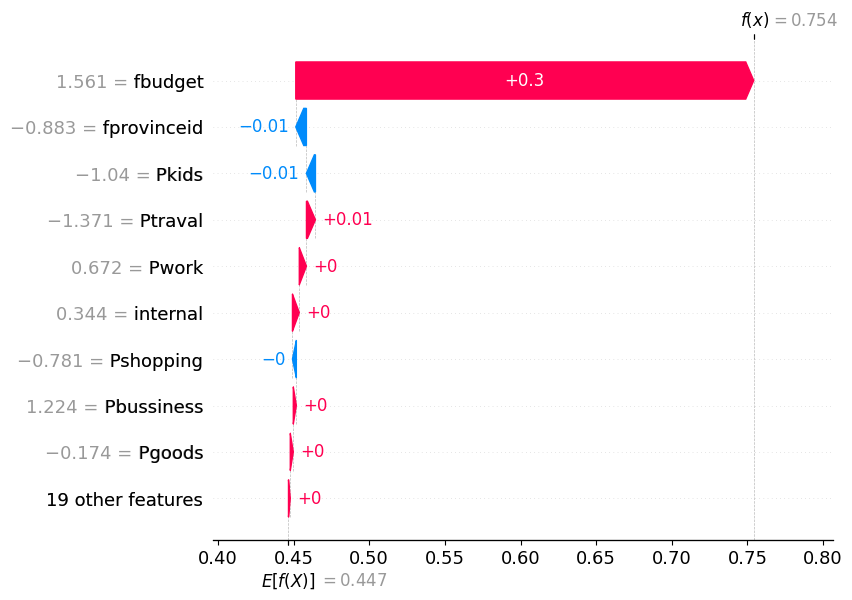

In [ ]:
# 可视化这个解释
shap.plots.waterfall(expl_user)

基于全市场的单一车型参数的影响购买因素倾向分析

In [ ]:
car_pre_vecs.shape

(12144, 155)

In [ ]:
# 选取需要分析的车型
id_car = 1000

In [ ]:
# 该车型的数据
scalerCar.inverse_transform(car_pre_vecs[id_car, :].reshape(1, -1)).astype(int)

array([[  44,    5,    1,    4,    6,   15,    0,    6,  102,  231,    1,
         180,    7,  180,  970,    2,    0,    7,    1,  292,  450,  170,
         340,   45,  110,    2,    2,    3,    0,    0,    2,    1,    2,
           1,    0,    1, 5250, 1960, 1920, 3110, 1675, 1675, 2665,    7,
           1,    2,    1,    1,    1,    2,    2,    2,    2,    1,    1,
           3,    1,    5,    4,    2,    1,    0,    2,    3,    2,    0,
           2,    6,    3,    1,    2,    0,    1,    1,    1,    1,    3,
           5,    4,    1,    2,    4,    2,    1,    6,    0,    1,    1,
           2,    1,    0,    5,    0,    2,    1,    1,    2,    4,    1,
           0,    2,   14,    2,    1,    1,    1,    0,    1,    1,    1,
           4,    3,    9,    2,    1,    2,    1,    2,    1,    1,    1,
           2,    1,    2,    8,    2,    1,   15,    2,    2,    1,    1,
           3,    2,  410, 2310,    2,    2,    2,    1,    0,    0,    1,
           1,    1,    1,    5,   80, 

In [ ]:
# 创建一个Explanation对象（车型特征）
expl_car = shap.Explanation(values=shap_values[0][0][id_car],
                        base_values=expected_value,
                        data=car_pre_vecs[id_car, :],
                        feature_names=car_dict_pre_features) # 请提供特征名称列表

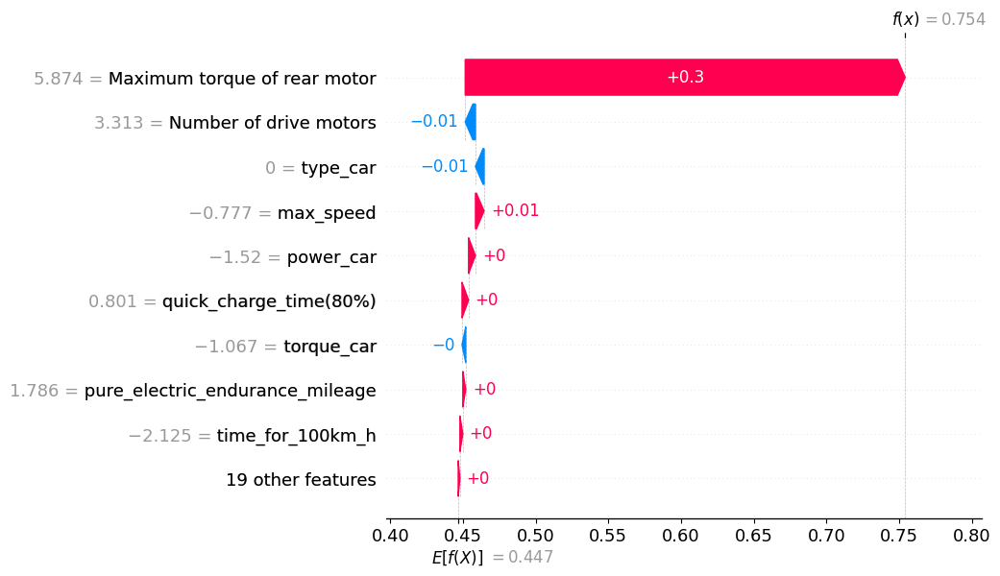

In [ ]:
# 可视化这个解释
shap.plots.waterfall(expl_car)

全市场全特征分析

In [ ]:
# 创建一个Explanation对象（用户特征）
expl_user_all = shap.Explanation(values=shap_values[0][0],
                        base_values=expected_value,
                        data=user_pre_vecs,
                        feature_names=dsc_up_pre_features) # 请提供特征名称列表

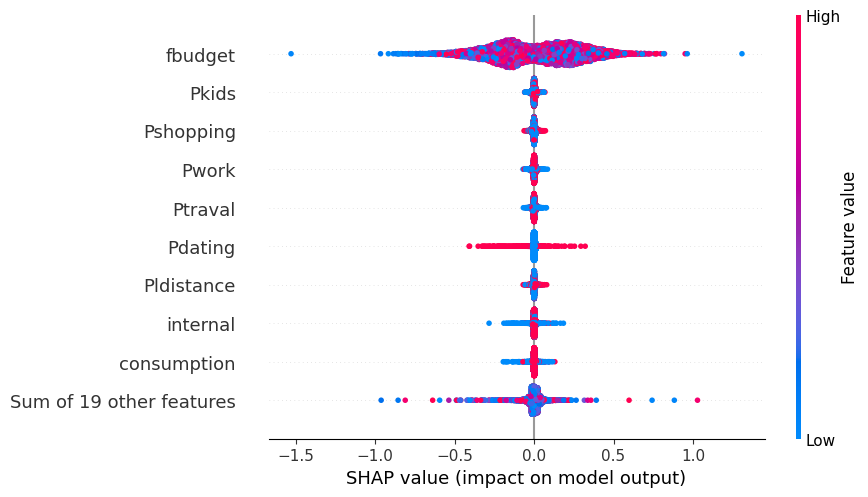

In [ ]:
# summarize the effects of all the features
shap.plots.beeswarm(expl_user_all)

In [ ]:
# 创建一个Explanation对象（车型特征）
expl_car_all = shap.Explanation(values=shap_values[0][1],
                        base_values=expected_value,
                        data=car_pre_vecs,
                        feature_names=car_dict_pre_features) # 请提供特征名称列表

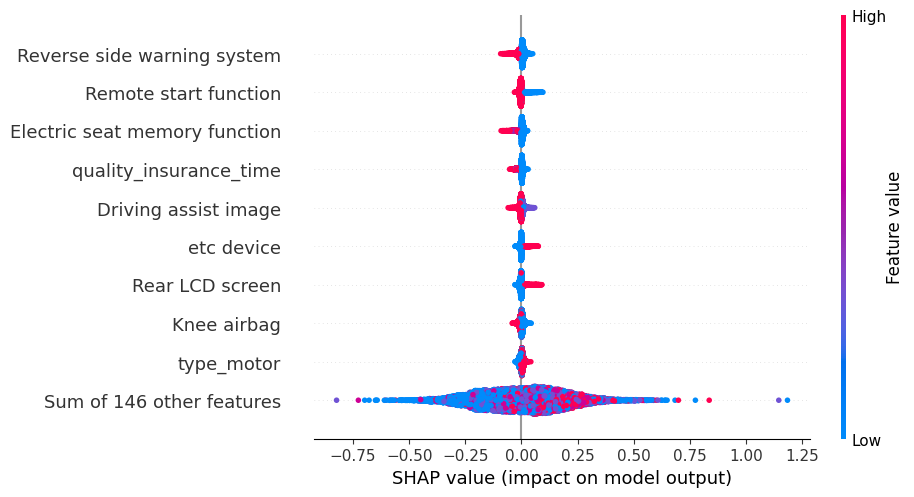

In [ ]:
# summarize the effects of all the features
shap.plots.beeswarm(expl_car_all)

# *E8特征分析*

In [ ]:
new_user_scal.shape

(5520, 28)

In [ ]:
new_car_scal.shape

(5520, 153)

In [ ]:
background_data_user_e8 = user_pre_vecs
background_data_car_e8 = car_pre_vecs

In [ ]:
explainer_e8 = shap.GradientExplainer(model, [background_data_user_e8, background_data_car_e8])

In [ ]:
shap_values_e8 = explainer_e8([new_user_scal, new_car_scal])

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


In [ ]:
np.mean(shap_values_e8[0][1].values, 0)

array([ 2.70129226e-03,  1.47517774e-02, -3.54886090e-03,  1.51317767e-02,
        7.18677243e-03, -2.89602336e-03, -1.48684131e-02,  3.64859038e-02,
        1.34922772e-02,  9.20476542e-03,  0.00000000e+00, -3.43475579e-04,
       -8.73580293e-04, -7.27297974e-03, -1.15181835e-04, -4.04763871e-04,
        4.49152128e-04, -3.23867765e-02,  5.80434012e-03,  2.51692229e-03,
       -9.51891778e-04,  3.50620025e-03,  2.92981115e-03, -1.79846289e-03,
       -1.66868635e-03,  2.62176147e-04,  3.49889499e-04,  2.11256614e-04,
       -7.96625381e-03, -5.73565253e-03,  9.27855416e-04,  0.00000000e+00,
        6.05786534e-04,  2.86773197e-02,  1.39146138e-03,  2.82237779e-02,
        1.00975658e-03,  4.42964903e-04, -7.45911618e-04,  6.21853041e-04,
       -5.03631528e-05, -6.94809457e-05,  2.17979360e-03,  3.60481425e-03,
       -8.97791446e-03, -4.94227152e-03,  2.31549851e-03,  4.30218856e-03,
        1.49594023e-03, -8.33460559e-03, -8.65272994e-03, -1.64349756e-02,
       -8.45516119e-03, -

In [ ]:
type(shap_values_e8[0][0])

shap._explanation.Explanation

In [ ]:
# 查看数据结构
print(type(shap_values_e8))
print(len(shap_values_e8))

# 我们只检查第一个元素，因为您的输出显示shap_values的长度为1
first_element = shap_values_e8[0]
print(type(first_element))
print(len(first_element))

# 现在我们看看这个列表的内容
for inner_value in first_element:
    print(type(inner_value))
    if isinstance(inner_value, np.ndarray):  # 如果它是一个ndarray，我们打印它的形状
        print(inner_value.shape)
    else:
        print(inner_value)  # 否则我们直接打印它的值

<class 'shap._explanation.Explanation'>
1
<class 'shap._explanation.Explanation'>
2
<class 'shap._explanation.Explanation'>
.values =
array([[ 2.16924516e-03,  6.06929883e-04, -9.44116153e-03, ...,
         1.77050149e-03, -3.48864356e-03,  7.27691595e-03],
       [-4.11792833e-04, -1.40083591e-02,  9.79366060e-03, ...,
         2.68081157e-03,  1.68225598e-02,  1.18567236e-03],
       [ 1.71661777e-05, -3.22817184e-04, -2.63951439e-03, ...,
        -9.32203548e-04, -1.82647665e-03,  6.00320240e-03],
       ...,
       [ 5.21139118e-05,  7.11762288e-04,  1.77332404e-04, ...,
         7.73835403e-04, -3.38254933e-04,  8.95496982e-04],
       [-4.41170123e-05,  5.28060889e-04,  4.49175527e-03, ...,
         1.76662358e-03, -2.69352715e-03, -7.92647887e-04],
       [ 1.06945168e-03,  1.94845942e-03, -2.73140706e-03, ...,
        -3.06247408e-03, -4.29728162e-03,  1.11587672e-03]])

.data =
array([ 0.06960737, -0.2439622 , -0.83905772,  3.39704977, -0.41324211,
       -0.12188682, -0.36798

In [ ]:
# 计算SHAP值的平均
meanab_shap_user_e8 = np.abs(shap_values_e8[0][0].values.mean(axis=0))
meanab_shap_car_e8 = np.abs(shap_values_e8[0][1].values.mean(axis=0))

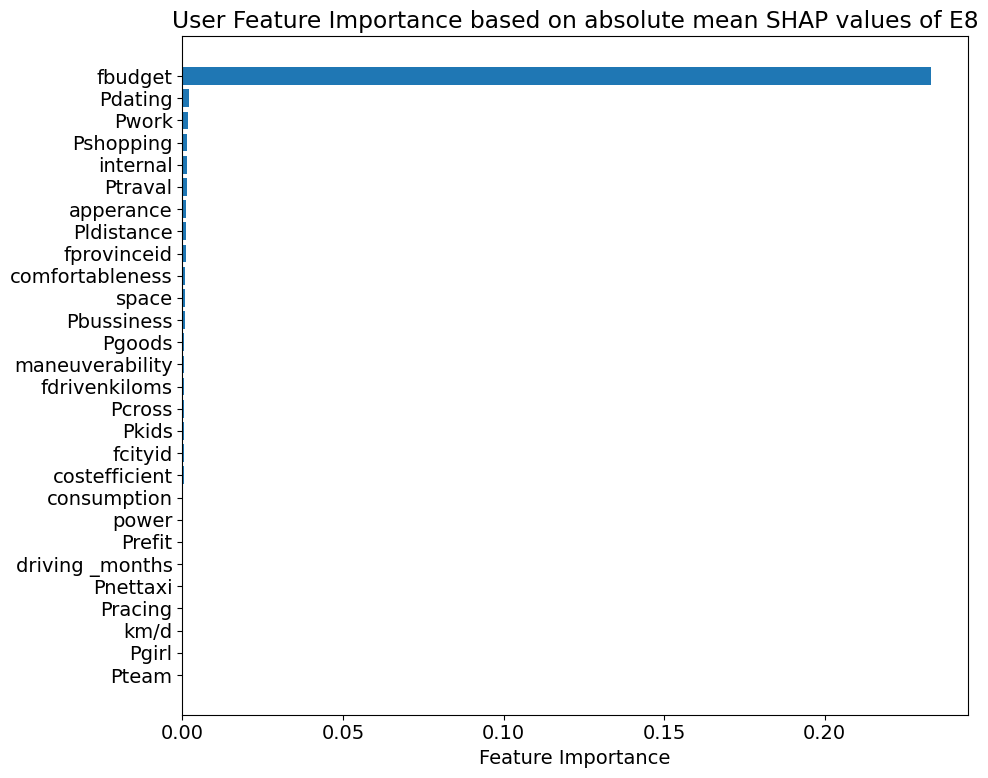

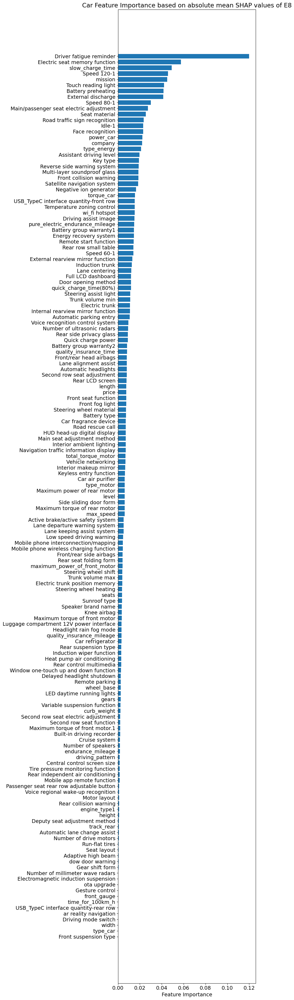

In [ ]:
# 绘制用户特征重要性
plt.figure(figsize=(10, 8))
sorted_idx_user = meanab_shap_user_e8.argsort()
plt.barh(range(new_user_scal.shape[1]), meanab_shap_user_e8[sorted_idx_user])
plt.yticks(range(new_user_scal.shape[1]), [dsc_up_pre_features[i] for i in sorted_idx_user])
plt.xlabel('Feature Importance')
plt.title('User Feature Importance based on absolute mean SHAP values of E8')
plt.tight_layout()
plt.savefig('/content/User_Feature_Importance_based_on_absolute_mean_SHAP_values_of_E8.png')
plt.show()

# 绘制汽车特征重要性
plt.figure(figsize=(10,38))
sorted_idx_car = meanab_shap_car_e8.argsort()
plt.barh(range(new_car_scal.shape[1]), meanab_shap_car_e8[sorted_idx_car])
plt.yticks(range(new_car_scal.shape[1]), [car_dict_pre_features[i] for i in sorted_idx_car])
plt.xlabel('Feature Importance')
plt.title('Car Feature Importance based on absolute mean SHAP values of E8')
plt.tight_layout()
plt.savefig('/content/Car_Feature_Importance_based_on_absolute_mean_SHAP_values_of_E8.png')
plt.show()


In [ ]:
# 计算SHAP值的中值的绝对值
abmedian_shap_user_e8 = np.abs(np.median(shap_values_e8[0][0].values, axis=0))
abmedian_shap_car_e8 = np.abs(np.median(shap_values_e8[0][1].values, axis=0))

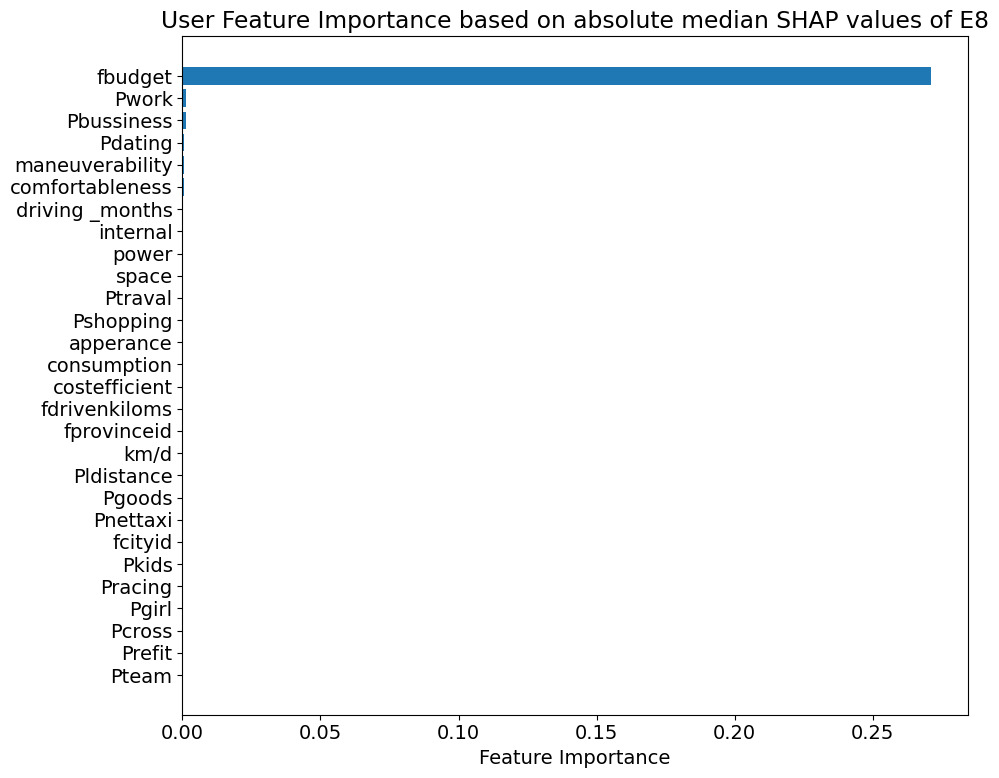

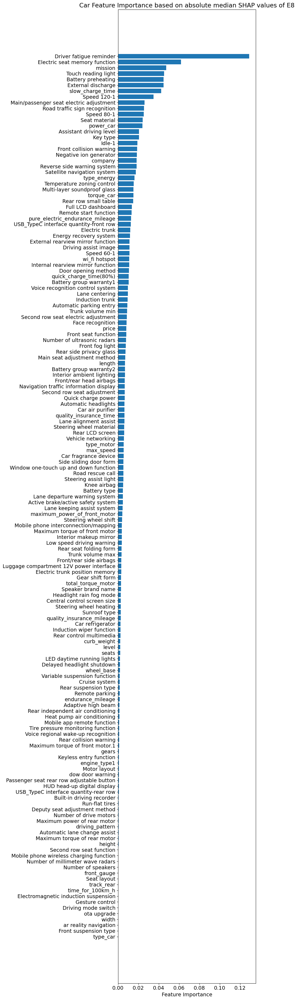

In [ ]:
# 绘制用户特征重要性
plt.figure(figsize=(10, 8))
sorted_idx_user = abmedian_shap_user_e8.argsort()
plt.barh(range(new_user_scal.shape[1]), abmedian_shap_user_e8[sorted_idx_user])
plt.yticks(range(new_user_scal.shape[1]), [dsc_up_pre_features[i] for i in sorted_idx_user])
plt.xlabel('Feature Importance')
plt.title('User Feature Importance based on absolute median SHAP values of E8')
plt.tight_layout()
plt.savefig('/content/User_Feature_Importance_based_on_absolute_median_SHAP_values_of_E8.png')
plt.show()

# 绘制汽车特征重要性
plt.figure(figsize=(10,38))
sorted_idx_car = abmedian_shap_car_e8.argsort()
plt.barh(range(new_car_scal.shape[1]), abmedian_shap_car_e8[sorted_idx_car])
plt.yticks(range(new_car_scal.shape[1]), [car_dict_pre_features[i] for i in sorted_idx_car])
plt.xlabel('Feature Importance')
plt.title('Car Feature Importance based on absolute median SHAP values of E8')
plt.tight_layout()
plt.savefig('/content/Car_Feature_Importance_based_on_absolute_median_SHAP_values_of_E8.png')
plt.show()


In [ ]:
# 计算SHAP值的中值
median_shap_user_e8 = np.median(shap_values_e8[0][0].values, axis=0)
median_shap_car_e8 = np.median(shap_values_e8[0][1].values, axis=0)

In [ ]:
median_shap_car_e8[53]

-0.004694534465670586

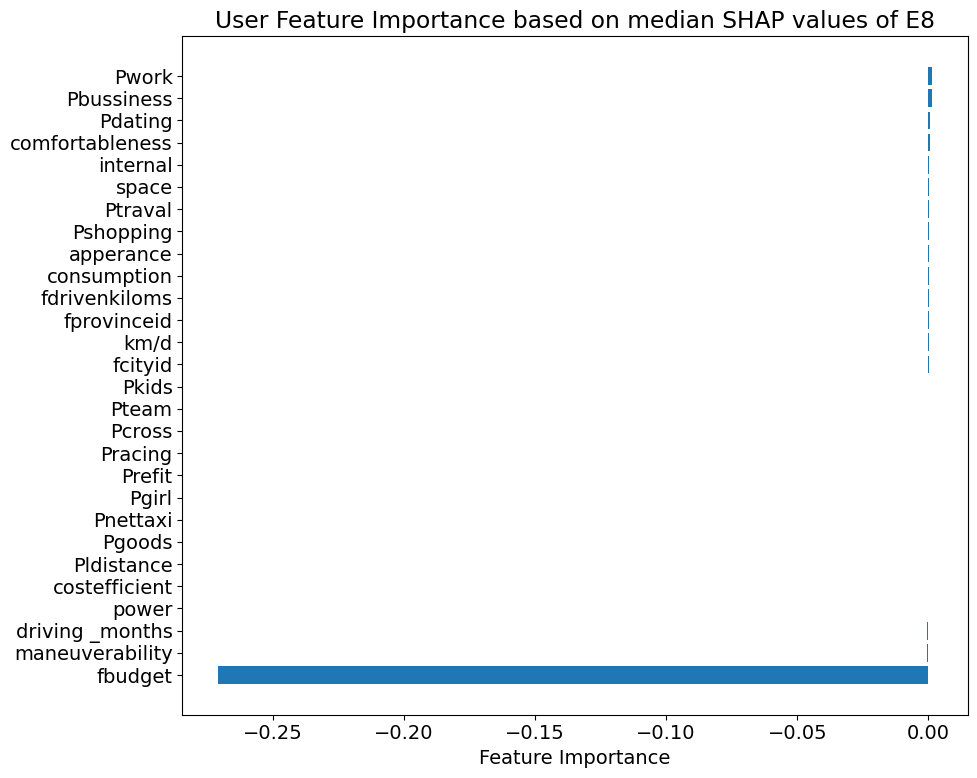

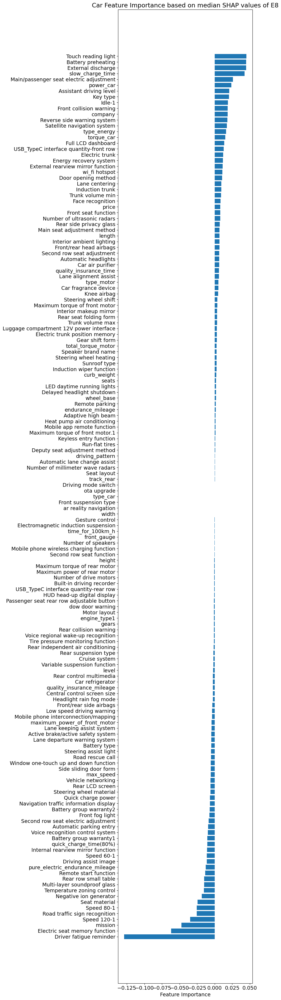

In [ ]:
# 绘制用户特征重要性
plt.figure(figsize=(10, 8))
sorted_idx_user = median_shap_user_e8.argsort()
plt.barh(range(new_user_scal.shape[1]), median_shap_user_e8[sorted_idx_user])
plt.yticks(range(new_user_scal.shape[1]), [dsc_up_pre_features[i] for i in sorted_idx_user])
plt.xlabel('Feature Importance')
plt.title('User Feature Importance based on median SHAP values of E8')
plt.tight_layout()
plt.savefig('/content/User_Feature_Importance_based_on_median_SHAP_values_of_E8.png')
plt.show()

# 绘制汽车特征重要性
plt.figure(figsize=(10,38))
sorted_idx_car = median_shap_car_e8.argsort()
plt.barh(range(new_car_scal.shape[1]), median_shap_car_e8[sorted_idx_car])
plt.yticks(range(new_car_scal.shape[1]), [car_dict_pre_features[i] for i in sorted_idx_car])
plt.xlabel('Feature Importance')
plt.title('Car Feature Importance based on median SHAP values of E8')
plt.tight_layout()
plt.savefig('/content/Car_Feature_Importance_based_on_median_SHAP_values_of_E8.png')
plt.show()


In [ ]:
# 使用模型对背景数据进行预测以获取基准值
background_predictions = model.predict([background_data_user_e8, background_data_car_e8])

# 使用背景数据的输出均值作为基准值
expected_value = np.mean(background_predictions)



380/380 [==============================] - 1s 2ms/step


In [ ]:
# 选取需要分析的用户
id_user_e8 = 1000

In [ ]:
# 该用户的数据
user_sample = scalerUser.inverse_transform(new_user_scal[id_user_e8, :].reshape(1, -1)).astype(int)
# 推荐给该用户的车型
car_sample = scalerCar.inverse_transform(new_car_scal[id_user_e8].reshape(1, -1)).astype(int)

In [ ]:

# 使用tabulate创建并打印表格
table_user = tabulate(user_sample, headers=dsc_up_pre_features, tablefmt="grid")
print(table_user)

table_car = tabulate(car_sample, headers=car_dict_pre_features, tablefmt="grid")
print(table_car)

print(f'该用户原选择了 {dsc_up[id_user_e8, 29]}')

+---------+---------+-------------------+---------------+-------------------+-------------+------------+-----------------+---------+-------------+---------+-----------+----------+--------------+--------------+-----------+----------+-----------+------------+----------+---------+---------+-----------------+-----------+-----------+---------------+-------------------+--------+
|   space |   power |   maneuverability |   consumption |   comfortableness |   apperance |   internal |   costefficient |   Pwork |   Pshopping |   Pkids |   Ptraval |   Pgoods |   Pbussiness |   Pldistance |   Pdating |   Pcross |   Pracing |   Pnettaxi |   Prefit |   Pteam |   Pgirl |   fdrivenkiloms |   fcityid |   fbudget |   fprovinceid |   driving _months |   km/d |
+=========+=========+===================+===============+===================+=============+============+=================+=========+=============+=========+===========+==========+==============+==============+===========+==========+===========+====

In [ ]:
# 创建一个Explanation对象（用户特征）
expl_user_e8 = shap.Explanation(values=shap_values_e8[0][0].values[id_user_e8],
                        base_values=expected_value,
                        data=new_user_scal[id_user_e8],
                        feature_names=dsc_up_pre_features) # 用户特征名称列表


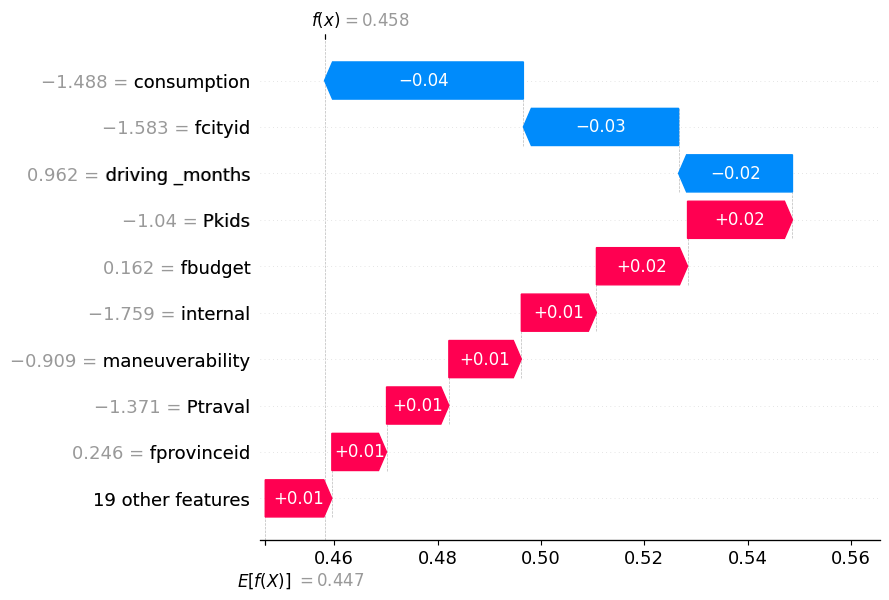

In [ ]:
# 可视化这个解释
shap.plots.waterfall(expl_user_e8)

In [ ]:
shap.plots.force(expl_user_e8)

In [ ]:
shap_values_e8[0][0].values[id_user_e8]

array([-7.58130918e-04, -5.70259115e-04,  1.40166394e-02, -3.84647995e-02,
        4.89518093e-03, -4.93424886e-04,  1.45294322e-02,  3.16596939e-04,
        9.81665030e-03,  5.05195837e-03,  2.02965569e-02,  1.20565416e-02,
        1.70225021e-03, -8.12896993e-03,  6.97010616e-03,  3.36711132e-03,
       -1.44411356e-03,  0.00000000e+00,  1.10788888e-03, -1.99907035e-10,
        0.00000000e+00,  0.00000000e+00, -8.34144838e-03, -3.00287232e-02,
        1.76270194e-02,  1.05819516e-02, -2.20257267e-02, -6.07686059e-04])

In [ ]:
 model.predict([[new_user_scal[id_user_e8].reshape(1, -1), new_car_scal[id_user_e8].reshape(1, -1)]])

1/1 [==============================] - 0s 22ms/step


array([[0.5996082]], dtype=float32)

In [ ]:
# 选取需要分析的车型
id_car_e8 = 100

In [ ]:
# 该车型的数据
car_sample = scalerCar.inverse_transform(new_car_scal[id_car_e8, :].reshape(1, -1)).astype(int)

# 推荐给该用户
user_sample = scalerUser.inverse_transform(new_user_scal[id_car_e8, :].reshape(1, -1)).astype(int)

In [ ]:
# 使用tabulate创建并打印表格
table_user = tabulate(user_sample, headers=dsc_up_pre_features, tablefmt="grid")
print(table_user)

table_car = tabulate(car_sample, headers=car_dict_pre_features, tablefmt="grid")
print(table_car)

print(f'该用户原选择了 {dsc_up[id_car_e8, 29]}')

+---------+---------+-------------------+---------------+-------------------+-------------+------------+-----------------+---------+-------------+---------+-----------+----------+--------------+--------------+-----------+----------+-----------+------------+----------+---------+---------+-----------------+-----------+-----------+---------------+-------------------+--------+
|   space |   power |   maneuverability |   consumption |   comfortableness |   apperance |   internal |   costefficient |   Pwork |   Pshopping |   Pkids |   Ptraval |   Pgoods |   Pbussiness |   Pldistance |   Pdating |   Pcross |   Pracing |   Pnettaxi |   Prefit |   Pteam |   Pgirl |   fdrivenkiloms |   fcityid |   fbudget |   fprovinceid |   driving _months |   km/d |
+=========+=========+===================+===============+===================+=============+============+=================+=========+=============+=========+===========+==========+==============+==============+===========+==========+===========+====

In [ ]:
# 创建一个Explanation对象（车型特征）
expl_car_e8 = shap.Explanation(values=shap_values_e8[0][1].values[id_car_e8],
                        base_values=expected_value,
                        data=new_car_scal[id_car_e8, :],
                        feature_names=car_dict_pre_features) # 请提供特征名称列表

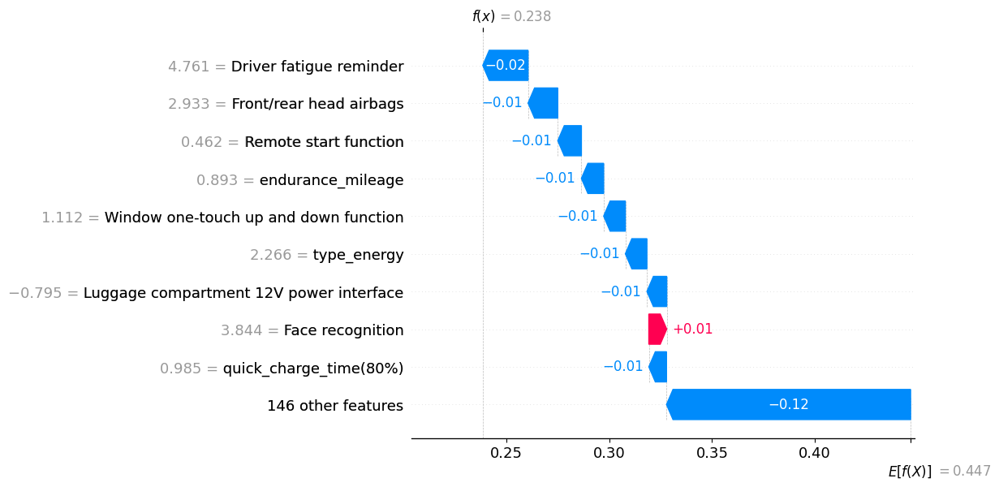

In [ ]:
# 可视化这个解释
shap.plots.waterfall(expl_car_e8)

In [ ]:
 model.predict([[new_user_scal[id_car_e8].reshape(1, -1), new_car_scal[id_car_e8].reshape(1, -1)]])

1/1 [==============================] - 0s 18ms/step


array([[0.02579812]], dtype=float32)

基于E8车型，全量特征分析

In [ ]:
# 创建一个Explanation对象（用户特征）
expl_user_all_e8 = shap.Explanation(values=shap_values_e8[0][0].values,
                        base_values=expected_value,
                        data=new_user_scal,
                        feature_names=dsc_up_pre_features) # 用户特征名称列表

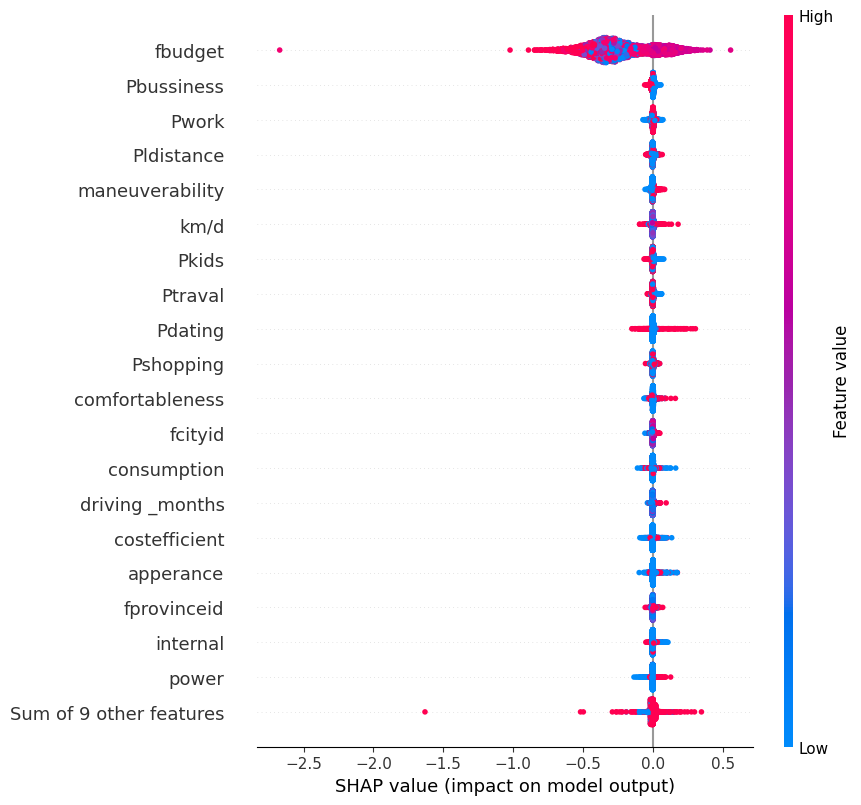

In [ ]:
# summarize the effects of all the features
shap.plots.beeswarm(expl_user_all_e8, 20)


In [ ]:
new_car_predict = np.concatenate((new_car_predict, dsc_up_new), axis=1)
new_car_predict_df = pd.DataFrame(new_car_predict)
new_car_predict_df.to_csv(r'/content/new_user_predict25WVS.csv', encoding='UTF-8')

In [ ]:
# 创建一个Explanation对象（车型特征）
expl_car_all_e8 = shap.Explanation(values=shap_values_e8[0][1].values,
                        base_values=expected_value,
                        data=new_car_scal,
                        feature_names=car_dict_pre_features) # 车型特征名称列表

In [ ]:
shap_values_e8[0][1].values

array([[ 1.27127562e-02,  3.65073979e-02,  7.69438781e-03, ...,
        -5.26093729e-02, -1.22587346e-01, -1.06973268e-01],
       [ 1.11740418e-02,  5.31301051e-02, -2.63402006e-03, ...,
        -5.72726764e-02, -1.35886773e-01, -1.21240132e-01],
       [ 1.49786742e-02,  3.28972973e-02, -1.12493802e-02, ...,
        -2.33882908e-02, -4.79692034e-02, -7.25857764e-02],
       ...,
       [-2.13062484e-02,  2.33421288e-03, -2.55937479e-03, ...,
         1.44122597e-02,  2.87872199e-02,  1.79253966e-02],
       [-2.10632873e-03,  4.40195063e-03, -1.15751731e-03, ...,
        -3.46729811e-03, -9.45529249e-03, -1.41693959e-02],
       [ 3.96965188e-04,  6.61448948e-03,  1.83705615e-05, ...,
        -6.39766594e-03, -1.57335103e-02, -1.54506555e-02]])

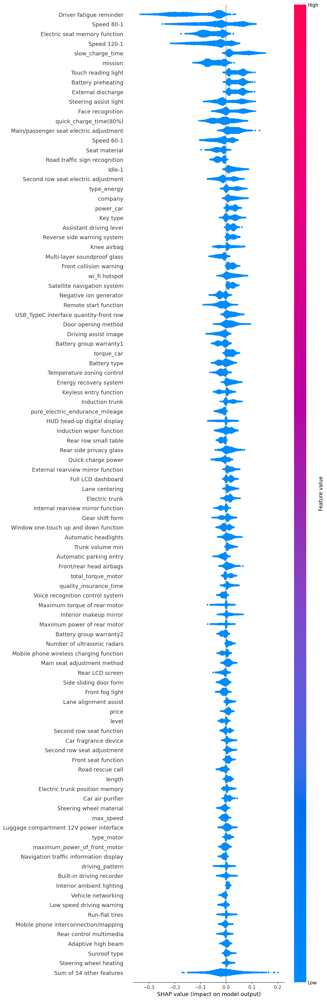

In [ ]:
# summarize the effects of all the features
shap.plots.beeswarm(expl_car_all_e8, 100)

In [ ]:
shap.initjs()
shap.force_plot(expl_user_all_e8)

In [ ]:
shap.initjs()
shap.force_plot(expl_car_all_e8)

shap.plots.force is slow for many thousands of rows, try subsampling your data.


In [ ]:
shap.decision_plot(expl_user_all_e8)

TypeError: ignored

In [ ]:
shap.decision_plot(expl_car_all_e8)

TypeError: ignored

In [ ]:
expl_user_all_e8 = shap.Explanation(values=shap_values_e8[0][0].values,
                        base_values=expected_value,
                        data=new_user_scal,
                        feature_names=dsc_up_pre_features) # 用户特征名称列表

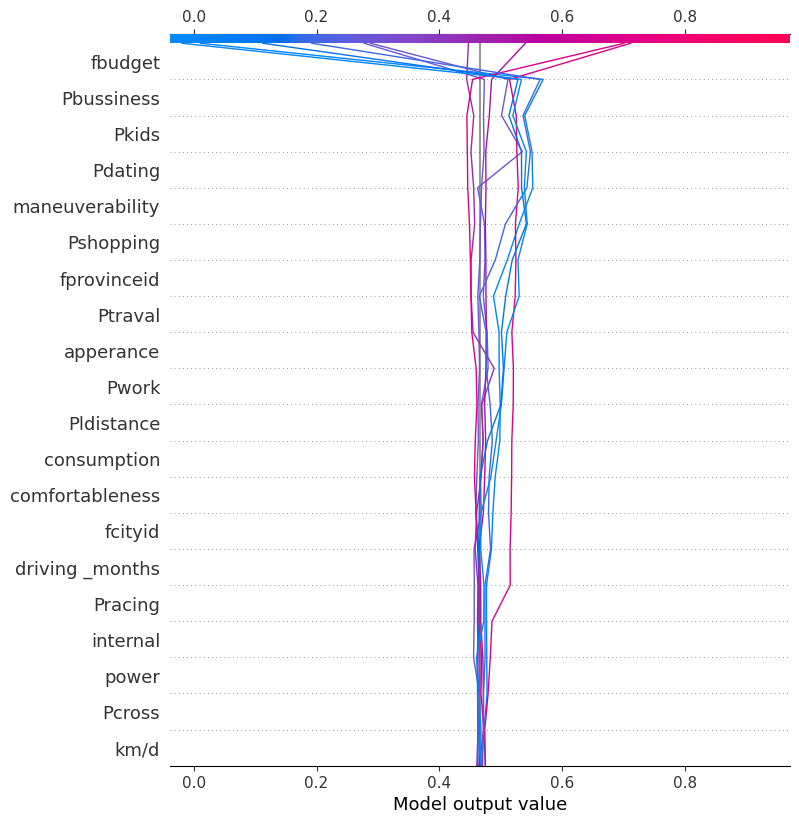

In [ ]:
shap.decision_plot(expected_value, shap_values_e8[0][0].values[100:110], new_user_scal[100:110], feature_names=dsc_up_pre_features, ignore_warnings=True)

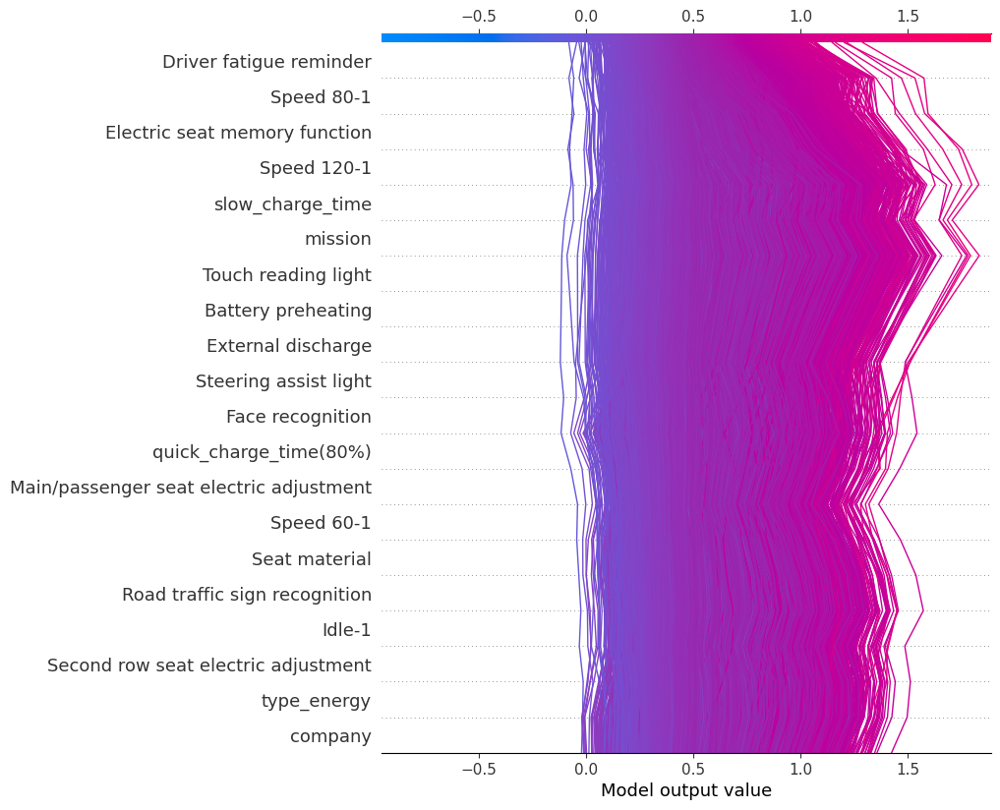

In [ ]:
shap.decision_plot(expected_value, shap_values_e8[0][1].values, new_car_scal, feature_names=car_dict_pre_features, ignore_warnings=True)

In [ ]:
expl_user_all_e8 = shap.Explanation(values=shap_values_e8[0][0].values,
                        base_values=expected_value,
                        data=new_user_scal,
                        feature_names=dsc_up_pre_features) # 用户特征名称列表

In [ ]:
expl_user_all_e8 = shap.Explanation(values=shap_values_e8[0][0].values,
                        base_values=expected_value,
                        data=new_user_scal,
                        feature_names=dsc_up_pre_features) # 用户特征名称列表

In [ ]:
shap_values_e8[0][1].values[0:5].shape

(5, 153)

In [ ]:
car_dict_pre_features.values

AttributeError: ignored

# 调试：

In [ ]:
# 创建解释器时
explainer3 = shap.PermutationExplainer(model, [background_data_user_e8, background_data_car_e8], max_evals=5000)

# 计算SHAP值
shap_values3 = explainer.shap_values([new_user_scal, new_car_scal])


In [ ]:
shap_values_e8 = shap_values3

In [ ]:
background_data_car_e8

array([[-0.21636947, -0.80437031,  0.90195077, ...,  2.46441639,
         3.31725385,  1.75083885],
       [-0.21636947, -0.80437031,  0.90195077, ...,  2.46441639,
         3.31725385,  1.75083885],
       [-0.21636947, -0.80437031,  0.90195077, ...,  2.46441639,
         3.31725385,  1.75083885],
       ...,
       [-0.21636947, -0.80437031,  0.90195077, ...,  2.46441639,
         3.31725385,  1.75083885],
       [-0.21636947, -0.80437031,  0.90195077, ...,  2.46441639,
         3.31725385,  1.75083885],
       [-0.21636947, -0.80437031,  0.90195077, ...,  2.46441639,
         3.31725385,  1.75083885]])

In [ ]:
shap_values_e8 = explainer2.shap_values([background_data_user_e8, background_data_car_e8])

In [ ]:
print(type(shap_values_e8))
print(len(shap_values_e8))

# 我们只检查第一个元素，因为您的输出显示shap_values的长度为1
first_element = shap_values_e8[0]
print(type(first_element))
print(len(first_element))

# 现在我们看看这个列表的内容
for inner_value in first_element:
    print(type(inner_value))
    if isinstance(inner_value, np.ndarray):  # 如果它是一个ndarray，我们打印它的形状
        print(inner_value.shape)
    else:
        print(inner_value)  # 否则我们直接打印它的值



<class 'list'>
1
<class 'list'>
2
<class 'numpy.ndarray'>
(3000, 28)
<class 'numpy.ndarray'>
(3000, 155)


In [ ]:
shap_values_e8

In [ ]:
# 计算SHAP值的平均
mean_shap_user_e8 = np.abs(shap_values_e8.values[0][0]).mean(axis=0)
mean_shap_car_e8 = np.abs(shap_values_e8.values[0][1]).mean(axis=0)

In [ ]:
shap_values_e8.shape

In [ ]:
shap.plots.waterfall(shap_values_e8[0][0][0, :])

In [ ]:
shap.plots.scatter(shap_values_e8[:, "Latitude"], color=shap_values)

In [ ]:
mean_shap_car_e8